<a href="https://colab.research.google.com/github/BismaMutiargo/cGAN_SurfaceRoughness/blob/main/cGAN_and_SurfaceRoughnessApplication_onSTL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')


gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mounted at /content/drive/
Tue May 30 16:55:35 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   49C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                             

In [ ]:
# !cat /proc/cpuinfo
!cat /proc/meminfo  

# import platform
# platform.system()
# platform.release()
# # platform.version()
# !pip show keras

In [ ]:
#@title README



'''This is a cGAN (conditional Generative Adversarial Network) implementation for surface roughness prediction for AM surface with optimal printing parameters

A. Starting point: Alicona .sur data
B. Import into surStand software -> Options --> Surface Filtering--> Under Form Filtering, click (2-degree Polynomial) --> Apply
C. Export as .CSV
D. Run a python script HeightMapVisualisation_randomisation_CSV.py script
    NOTE: this is a randomisation script that converts the heightmap into a 16 bit grayvalue map, and also to tile the surfaces into smaller pieces so we can get more data
          Each "angle" should be saved under a different folders with its corresponding angle names. for example 0 degree images should be saved in folders named 0, and so on
          Upload to google drive under folder GAN/DATA/


E. Structure of the folder:

       ./drive/MyDrive/GAN/Data/
                                0/  1.png
                                    2.png
                                    ...
                                    600.png
                                30/ 1.png
                                    2.png
                                    ...
                                60/ 1.png
                                    2.png
                                    ....
                                90/ 1.png
                                    2.png
                                    ....
                                120/1.png
                                    2.png
                                    ....
                                135/1.png
                                    2.png
                                    ....

   NOTE:    each folder should contain at least 600 images of a 16-bit grayvalue, .PNG images
            0,30,60,120,135 represents the angle, which in this case is classes (6)


--------------------------------------------------
TO IMPLEMENT ON STL (LAST CELL):
NOTE: MUST MAKE SURE PYVISTA IS INSTALLED !PIP INSTALL PYVISTA

1. CREATE A SMOOTH .STL file from a CAD software
2. SUBDIVIDE IT SO THAT THE TRIANGLES ARE REALLY SMALL
    - Import the STL into MeshLab
    - Filters --> Remeshing,simplifications&Reconstructions--> Remeshing: Isotropic Explicit Remeshing
    - Adjust the Target Length (World unit) to 1
    - Keep applying it until the size of the triangles doesnt change anymore
3. UPLOAD THE STL FILE ONTO COLAB DRIVE
4. RUN THE LAST CELL 
    NOTE: THE RANGE THAT IS PROVIDED BY THE HEIGHTMAP IS A NORMALISED HEIGHTMAP, AND YOU WILL NEED TO SCALE IT IN ORDER TO GET A REALISTIC HEIGHTMAP. 
          YOU WILL NEED EXPERIMENT WITH WHAT IS THE APPROPRIATE SCALING VARIABLE UNTIL YOU ARE HAPPY WITH IT
5. DOWNLOAD THE OUTPUT
6. BAM        

'''


''' This code is all rights reserved to Bisma Mutiargo @ 2023, Developed in the University of Huddersfield (EPSRC Future Metrology Hub),  as part of the MSc by Research program in 11 May 2023 '''

' This code is all rights reserved to Bisma Mutiargo @ 2023, Developed in the University of Huddersfield (EPSRC Future Metrology Hub),  as part of the MSc by Research program in 11 May 2023 '

In [ ]:
###start code
import tensorflow as tf
from tensorflow.keras.layers import Embedding, multiply
from tensorflow import concat
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Dropout, Concatenate, Conv2D, Conv2DTranspose, LeakyReLU, BatchNormalization
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam
import numpy as np
import glob
import imageio
import matplotlib.pyplot as plt
import os
from keras.layers import Activation
import math
from tqdm import tqdm

# Define the generator network
def build_generator(seed_size, channels, num_classes):
    noise = Input(shape=(seed_size,))
    label = Input(shape=(num_classes,))
    
    x = Concatenate()([noise, label])
    x = Dense(8*8*512, activation="relu")(x)
    x = Reshape((8, 8, 512))(x)

    x = Conv2DTranspose(256, kernel_size=3, strides=2, padding="same")(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = Activation("relu")(x)

    x = Conv2DTranspose(128, kernel_size=3, strides=2, padding="same")(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = Activation("relu")(x)

    x = Conv2DTranspose(64, kernel_size=3, strides=2, padding="same")(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = Activation("relu")(x)

    x = Conv2DTranspose(channels, kernel_size=3, strides=2, padding="same")(x)
    output = Activation("tanh")(x)

    return Model([noise, label], output)


def build_discriminator(image_shape, num_classes):
    image_input = Input(shape=image_shape)
    label_input = Input(shape=(num_classes,))

    # Reshape the labels and repeat them across the image dimensions
    label_reshaped = Reshape((1, 1, num_classes))(label_input)
    label_repeated = tf.keras.layers.UpSampling2D(size=(image_shape[0], image_shape[1]))(label_reshaped)

    # Concatenate the labels with the image
    combined = Concatenate(axis=-1)([image_input, label_repeated])

    x = Conv2D(64, kernel_size=5, strides=2, input_shape=image_shape, padding="same")(combined)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(128, kernel_size=5, strides=2, padding="same")(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(256, kernel_size=5, strides=2, padding="same")(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(512, kernel_size=5, strides=2, padding="same")(x)
    x = BatchNormalization(momentum=0.8)(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(1, kernel_size=5, strides=1, padding="same")(x)
    x = Flatten()(x)
    output = Dense(1, activation='sigmoid')(x)

    return Model([image_input, label_input], output)


# Define the loss functions
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

# Define the optimizers
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)


Generator summary:
Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_9 (InputLayer)           [(None, 100)]        0           []                               
                                                                                                  
 input_10 (InputLayer)          [(None, 6)]          0           []                               
                                                                                                  
 concatenate_4 (Concatenate)    (None, 106)          0           ['input_9[0][0]',                
                                                                  'input_10[0][0]']               
                                                                                                  
 dense_4 (Dense)                (None, 32768)        3506176     ['concat

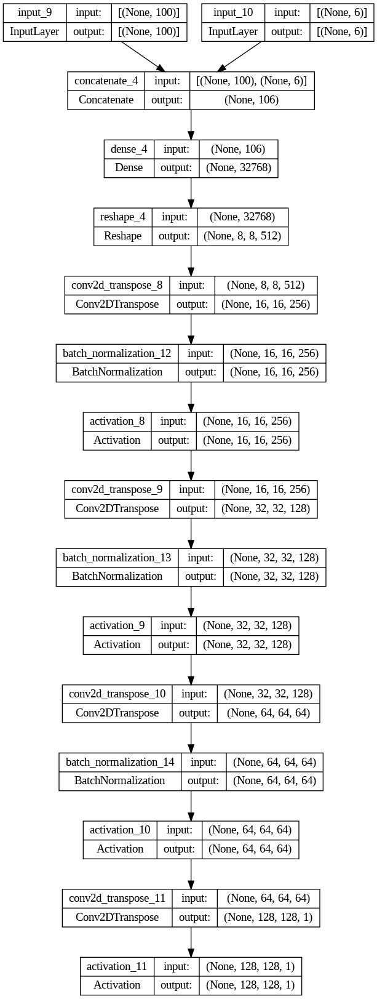

In [ ]:
# Define model parameters
SEED_SIZE = 100  # Dimensionality of the latent space
CHANNELS = 1  # RGB channels
NUM_CLASSES = 6  # Number of classes for your labels (for example, 10 for CIFAR-10 dataset)

# Define the image shape
IMAGE_SHAPE = (128, 128, CHANNELS)  # Change this as per your input image dimensions

# Build the generator
generator = build_generator(SEED_SIZE, CHANNELS, NUM_CLASSES)

# Build the discriminator
discriminator = build_discriminator(IMAGE_SHAPE, NUM_CLASSES)

# Print the model summaries
print("Generator summary:")
generator.summary()

print("\nDiscriminator summary:")
discriminator.summary()


from tensorflow.keras.utils import plot_model

# Plot the generator
plot_model(generator, to_file='generator.png', show_shapes=True, show_layer_names=True)

# # Plot the discriminator
# plot_model(discriminator, to_file='discriminator.png', show_shapes=True, show_layer_names=True)


In [ ]:
'''
Loss Function:
1. Categorical Cross-entropy
2. 
'''

'\nLoss Function:\n1. Categorical Cross-entropy\n2. \n'

In [ ]:
#@title [OLD] Train_step for manual BATCH_SIZE
# # @tf.function
# def train_step(images, labels):
#     noise = tf.random.normal([BATCH_SIZE, 100])

#     with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
#         generated_images = generator([noise, labels], training=True)

#         real_output = discriminator([images, labels], training=True)
#         fake_output = discriminator([generated_images, labels], training=True)

#         gen_loss = generator_loss(fake_output)
#         disc_loss = discriminator_loss(real_output, fake_output)

#     gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
#     gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

#     generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
#     discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))


In [ ]:


# @tf.function
def train_step(images, labels):
    batch_size = tf.shape(images)[0]  # Determine the current batch size
    noise = tf.random.normal([batch_size, 100])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator([noise, labels], training=True)

        real_output = discriminator([images, labels], training=True)
        fake_output = discriminator([generated_images, labels], training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))



In [ ]:

def load_data():
    # Define the path to the data folders
    data_path = ['./drive/MyDrive/GAN/data/0', './drive/MyDrive/GAN/data/30', './drive/MyDrive/GAN/data/60', './drive/MyDrive/GAN/data/90', './drive/MyDrive/GAN/data/120' , './drive/MyDrive/GAN/data/135']
    num_classes = len(data_path)
    
    # Load the images from each folder into separate arrays
    data = []
    labels = []
    i = 0
    print('importing now')
    for path in data_path:
        print('importing from: '+ path)
        images = []
        for img_path in glob.glob(path + '/*.png'):
            # print(i)
            img = imageio.imread(img_path)
            img = np.expand_dims(img, axis=-1) # Add an extra dimension for grayscale
            images.append(img)
        data.append(np.array(images))
        labels.append(np.full(len(images), i))  # Create labels for this class
        i = i+1
    print('completed the append, now will concatenate and Normalise')    
    
    # Combine the images from all folders into a single array
    data = np.concatenate(data, axis=0)
    labels = np.concatenate(labels, axis=0)

    # Normalize the pixel values to [-1, 1]
    data = (data.astype(np.float32) - 32768.0) / 32768.0

    return data, tf.one_hot(labels, num_classes)  # Return one-hot encoded labels


# Define the learning rate schedule function
def step_decay(epoch):
   initial_lrate = 0.001
   drop = 0.5
   epochs_drop = 50.0
   lrate = initial_lrate * math.pow(drop, math.floor((1+epoch)/epochs_drop))
   return lrate




def interpolate_classes(generator, class1, class2, steps):
    # Create a batch of latent vectors. We'll generate one sample for each step.
    latent = tf.random.normal([steps, 100])

    # Create a vector of class labels, changing linearly from class1 to class2.
    interpolated_labels = np.zeros((steps, 6))  # Change this to match your number of classes
    for i in range(steps):
        alpha = i / (steps - 1)  # alpha goes from 0 to 1 as i goes from 0 to steps-1
        interpolated_labels[i, :] = (1 - alpha) * class1 + alpha * class2

    # Use the generator to generate images for each combination of latent vector and class label.
    generated_images = generator([latent, interpolated_labels])

    return generated_images



In [ ]:
# Add the necessary imports
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
import numpy as np
from scipy.stats import skew, kurtosis
from skimage.feature import peak_local_max
import os
import random
from PIL import Image
import numpy as np


# Function to calculate Rq and Ra
def calculate_roughness(height_map):
    Rq = np.sqrt(np.mean(height_map**2))
    Ra = np.mean(np.abs(height_map))
    return Rq, Ra


def calculate_sdr(image):

    # Normalize the image to [0,1]
    image = image / 65535.0

    # Calculate the differences between neighboring pixel values
    dx = np.diff(image, axis=1)
    dy = np.diff(image, axis=0)

    # Pad the difference images with zeros on one side to make them the same size as the original image
    dx = np.pad(dx, ((0, 0), (0, 1)))
    dy = np.pad(dy, ((0, 1), (0, 0)))

    # Calculate the surface area contribution of each pixel
    dA = np.sqrt(dx**2 + dy**2 + 1)

    # Calculate the total surface area
    A = np.sum(dA)

    # Calculate the ideal surface area
    A0 = image.size

    # Calculate the Developed Interfacial Area Ratio
    Sdr = (A - A0) / A0

    return Sdr



def calculate_sdq(image):
    # Calculate the gradients of the image
    dx, dy = np.gradient(image)
    
    # Calculate the magnitudes of the gradients
    magnitudes = np.sqrt(dx**2 + dy**2)
    
    # Calculate Sdq
    Sdq = np.sqrt(np.mean(magnitudes**2))
    
    return Sdq


def calculate_ssk(height_map):

  '''
  formula : Ssk = (1/Sq^3)*(1/nx/ny)*sum(sum(z.^3))
  where nx and ny refers to the dimension of the image. in this case our image is fixed (128x128) thus nx/ny = 1
  Sq refers to the root mean square

  '''
  # rq,ra = calculate_roughness(height_map)

  # height_map_Cubed = height_map**3
  # height_map_cubed_sum = sum(sum(height_map_Cubed))


  # Ssk = (1/ (rq**3))*1*height_map_cubed_sum
  Ssk = skew(height_map.flatten())

  return Ssk

# Function to count peaks
def count_peaks(height_map, min_distance=1, threshold_abs=0):
    coordinates = peak_local_max(height_map, min_distance=min_distance, threshold_abs=threshold_abs)
    return len(coordinates)

# Function to calculate parameters
def calculate_parameters(height_map):
    height_map = np.array(height_map)  # Make sure the input is numpy array
    ssk = skew(height_map.flatten())
    sku = kurtosis(height_map.flatten())
    Rq, Ra = calculate_roughness(height_map)
    peak_count = count_peaks(height_map)
    return [ssk, sku, Rq, Ra, peak_count]





# Function to normalize the parameters
def normalize_parameters(parameters):
    scaler = MinMaxScaler()
    return scaler.fit_transform(parameters)


def reverse_interpolate_class(Trained_Class, input_value):
    # Define the corresponding class values
    Class_values = np.arange(len(Trained_Class))
    
    # Return the interpolated result
    return np.interp(input_value, Trained_Class, Class_values)

In [ ]:
'''

This definition is only valid for 6 classes training 0,30,60,90,120,135!

'''

def DisplayAndSaveImages(epoch,trained_classes_one_hot ):

  # # Define the classes that the model was trained on
  # trained_classes = [0, 30, 60, 90, 120, 135]
  # trained_classes_one_hot = [tf.one_hot([i], depth=6)[0] for i in trained_classes]

  # Define the classes you want to generate, this case is 0-13
  desired_classes = list(range(11))
  # Create a figure for the subplots
  fig, axs = plt.subplots(3, 4, figsize=(15, 10))  # Adjust the numbers and size as needed


  # Flatten axs for easy indexing
  axs = axs.flatten()

  # Generate an image for each desired class
  for i in range(len(axs)):
      axs[i].axis('off')  # initially set all to off
      if i < len(desired_classes):
          desired_class = desired_classes[i]
          # Find the two closest trained classes
          #here2
          closest_classes = sorted(trained_classes, key=lambda x: abs(x - desired_class))[:2]
          class1, class2 = closest_classes

          # Find the corresponding one-hot encoded classes
          class1_one_hot = trained_classes_one_hot[trained_classes.index(class1)]
          class2_one_hot = trained_classes_one_hot[trained_classes.index(class2)]

          # Calculate the interpolation coefficient
          total_diff = class2 - class1
          desired_diff = desired_class - class1
          alpha = desired_diff / total_diff

          # Interpolate between the two closest trained classes
          interpolated_class = (1 - alpha) * class1_one_hot + alpha * class2_one_hot

          # Generate and display the image
          interpolated_images = generator.predict([np.random.normal(0, 1, (1, 100)), np.array([interpolated_class])])
          generated_image = interpolated_images[0]
          generated_image = (generated_image[:, :, 0] * 32768.0 + 32768.0).astype(np.uint16)

          # Display The Image on the subplot
          axs[i].imshow(generated_image, cmap='gray')
          axs[i].set_title(f'{desired_class*15} °', y=-0.2)
          # axs[i].axis('on')  # show the axes for used ones
      elif i == len(axs) - 1:  # if we are at the last subplot
          axs[i].text(0.5, 0.5, f'Epoch: {epoch}', ha='center', va='center', fontsize=20)  # Add a title in the center of the last subplot

  # Show the plot with all the subplots
  plt.tight_layout(pad=3.0)
  plt.savefig(f'./drive/MyDrive/GAN/EpochOutput/{epoch} - output.png', dpi=300)  # save the figure
  plt.show()



def select_random_real_image(class_index):
    # Define the paths for each class
    class_paths = ['./drive/MyDrive/GAN/data/0/',
                   './drive/MyDrive/GAN/data/30/',
                   './drive/MyDrive/GAN/data/60/',
                   './drive/MyDrive/GAN/data/90/',
                   './drive/MyDrive/GAN/data/120/',
                   './drive/MyDrive/GAN/data/135/']

    # Select the path for the current class
    class_path = class_paths[class_index]

    # Get a list of all image files in the class directory
    image_files = [f for f in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, f))]

    # Select a random image file
    selected_image_file = random.choice(image_files)

    # Load the image file as a numpy array
    image = Image.open(os.path.join(class_path, selected_image_file))
    image_array = np.array(image)

    return image_array

def import_the_first_n_image(class_index, numberImages):
      # Define the paths for each class
    class_paths = ['./drive/MyDrive/GAN/data/0/',
                   './drive/MyDrive/GAN/data/15/', #interpolation exercise
                   './drive/MyDrive/GAN/data/30/',
                   './drive/MyDrive/GAN/data/45/', #interpolation exercise
                   './drive/MyDrive/GAN/data/60/', 
                   './drive/MyDrive/GAN/data/75/', #interpolation exercise
                   './drive/MyDrive/GAN/data/90/',
                   './drive/MyDrive/GAN/data/105/', #interpolation exercise
                   './drive/MyDrive/GAN/data/120/',
                   './drive/MyDrive/GAN/data/129/', #interpolation exercise
                   './drive/MyDrive/GAN/data/135/']


    # class_paths = ['./drive/MyDrive/GAN/data/0/',
    #             './drive/MyDrive/GAN/data/30/',
    #             './drive/MyDrive/GAN/data/60/', 
    #             './drive/MyDrive/GAN/data/90/',
    #             './drive/MyDrive/GAN/data/120/',
    #             './drive/MyDrive/GAN/data/135/']

    # Select the path for the current class
    class_path = class_paths[class_index]
    # Get a list of all image files in the class directory
    image_files = [f for f in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, f))]
    print(f'importing the first {numberImages} from class {class_index}')
    ImportedList = []
    with tqdm(total=numberImages, ncols=80) as pbar:
      for i in range(numberImages):
        image = Image.open(os.path.join(class_path, image_files[i]))
        image_array = np.array(image)

        # print(image_array.shape)
        # image_array = (image_array.astype(np.float32) - 32768.0) / 32768.0



        ImportedList.append(image_array)
        pbar.update(1)
    
    imported_array = np.asarray(ImportedList)
    print(f'\n returning image with size {imported_array.shape}')
    return imported_array

def plot_parameters(real_parameters, generated_parameters, epoch):
    classes = ["0", "30", "60", "90", "120", "135"]
    parameters_names = ["Ssk", "Kurtosis", "Rq", "Ra", "Peak Count"]
    markers = ['o', 'v', 's', 'p', 'D']
    colors = ['g', 'b']

    plt.figure(figsize=(27, 8))

    for i in range(5):  # Loop over parameters
        plt.scatter(classes, [param[i] for param in real_parameters], color=colors[0], marker=markers[i], label=f'Real {parameters_names[i]}')
        plt.scatter(classes, [param[i] for param in generated_parameters], color=colors[1], marker=markers[i], label=f'Generated {parameters_names[i]}')

    plt.xlabel('Classes')
    plt.ylabel('Parameters Value (normalized)')
    plt.title(f'Parameters for Real and Generated Images at Epoch {epoch}')
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')

    plt.savefig(f'./drive/MyDrive/GAN/EpochOutputParams/{epoch}.png')
    # plt.show()
    plt.close()



In [ ]:
#@title [OLD]This is the cell that contains the running main function for training 4 classes. the batch number is hard coded

# BATCH_SIZE = 32
# EPOCHS = 1500


# # Define the optimizers with initial learning rate
# initial_lrate = 0.1
# generator_optimizer = tf.keras.optimizers.Adam(initial_lrate)
# discriminator_optimizer = tf.keras.optimizers.Adam(initial_lrate)


# # Create the generator and discriminator networks
# generator = build_generator(seed_size=100, channels=1, num_classes=6) #change the num_classes to 181 later
# discriminator = build_discriminator(image_shape=(128, 128, 1), num_classes=6)  #change the num_classes to 181 later

# # Load the data and labels
# data, labels = load_data()


# # Create a TensorFlow dataset from the data array and the labels
# dataset = tf.data.Dataset.from_tensor_slices((data, labels)).shuffle(600).batch(BATCH_SIZE)

# # Train the GAN
# for epoch in range(EPOCHS):
#     # Update learning rate
#     new_lrate = step_decay(epoch)
#     generator_optimizer.learning_rate = new_lrate
#     discriminator_optimizer.learning_rate = new_lrate

#     for batch, labels in dataset:
#         train_step(batch, labels)
    
#     # Generate a sample image every 5 epochs and display it
#     if epoch % 5 == 0:
#         noise = tf.random.normal([1, 100])
        
#         label_sample = tf.one_hot([0], depth=6)  # #change the depth to 181 later

#         generated_image = generator([noise, label_sample], training=False)
#         generated_image = (generated_image[0, :, :, 0] * 32768.0 + 32768.0).numpy().astype(np.uint16)
#         plt.imshow(generated_image, cmap='gray')
#         plt.show()


In [ ]:
#@title [OLD-WORKING] THIS IS A WORKING TRAINING MAIN FUNCTION, BUT IT DOESNT HAVE A NICE VISUALISATION OF INTERPOLATED CLASS

# '''
# TRAINING THE DATA

# '''


# BATCH_SIZE = 32
# EPOCHS = 1500


# # Define the optimizers with initial learning rate
# initial_lrate = 0.1
# generator_optimizer = tf.keras.optimizers.Adam(initial_lrate)
# discriminator_optimizer = tf.keras.optimizers.Adam(initial_lrate)


# # Create the generator and discriminator networks
# generator = build_generator(seed_size=100, channels=1, num_classes=6) #change the num_classes to 181 later
# discriminator = build_discriminator(image_shape=(128, 128, 1), num_classes=6)  #change the num_classes to 181 later

# # Load the data and labels
# data, labels = load_data()


# # Create a TensorFlow dataset from the data array and the labels
# dataset = tf.data.Dataset.from_tensor_slices((data, labels)).shuffle(600).batch(BATCH_SIZE)

# # Train the GAN
# for epoch in range(EPOCHS):
#     # Update learning rate
#     new_lrate = step_decay(epoch)
#     generator_optimizer.learning_rate = new_lrate
#     discriminator_optimizer.learning_rate = new_lrate

#     for images_batch, labels_batch in dataset:
#         train_step(images_batch, labels_batch)
    
#     # Generate a sample image every 5 epochs and display it
#     if epoch % 5 == 0:
#         noise = tf.random.normal([1, 100])
        
#         label_sample = tf.one_hot([0], depth=6)  # #change the depth to 181 later

#         generated_image = generator([noise, label_sample], training=False)
#         generated_image = (generated_image[0, :, :, 0] * 32768.0 + 32768.0).numpy().astype(np.uint16)
#         plt.imshow(generated_image, cmap='gray')
#         plt.show()



In [ ]:
#@title !!!TRAINING CELL!!! : This is the cell that runs the training and visualise the result in every epoch. 


'''
Training the data 

'''

BATCH_SIZE = 32
EPOCHS = 1500


# Define the optimizers with initial learning rate
initial_lrate = 0.1
generator_optimizer = tf.keras.optimizers.Adam(initial_lrate)
discriminator_optimizer = tf.keras.optimizers.Adam(initial_lrate)


# Create the generator and discriminator networks
generator = build_generator(seed_size=100, channels=1, num_classes=6) #change the num_classes to 181 later
discriminator = build_discriminator(image_shape=(128, 128, 1), num_classes=6)  #change the num_classes to 181 later

# Load the data and labels
data, labels = load_data()


# Create a TensorFlow dataset from the data array and the labels
dataset = tf.data.Dataset.from_tensor_slices((data, labels)).shuffle(600).batch(BATCH_SIZE)




# Define the classes that the model was trained on
trained_classes = [0, 30, 60, 90, 120, 135]
trained_classes_one_hot = [tf.one_hot([i], depth=6)[0] for i in trained_classes]


# Train the GAN
for epoch in range(EPOCHS):
    # Update learning rate
    new_lrate = step_decay(epoch)
    generator_optimizer.learning_rate = new_lrate
    discriminator_optimizer.learning_rate = new_lrate

    for batch, labels in dataset:
        train_step(batch, labels)
    
    # Generate a sample image every 5 epochs and display it, and save the G and D
    if epoch % 5 == 0:
      DisplayAndSaveImages(epoch, trained_classes_one_hot)

      #save the generator 
      generator.save('drive/MyDrive/GAN/GEN_cGAN_0-135_LAST.h5')
      discriminator.save('drive/MyDrive/GAN/DIS_cGAN_0-135_LAST.h5')


    # Calculate parameters for each trained class after each epoch
    with open('drive/MyDrive/GAN/Epoch-parameters.txt', 'a') as f:
        generated_parameters = []
        real_parameters = []
        for i, trained_class in enumerate(trained_classes):
            # Generate the image for the trained class
            class_one_hot = trained_classes_one_hot[trained_classes.index(trained_class)]
            generated_image = generator.predict([np.random.normal(0, 1, (1, 100)), np.array([class_one_hot])])
            generated_image = (generated_image[:, :, 0] * 32768.0 + 32768.0).astype(np.uint16)

            # Calculate parameters and write to file
            parameters = calculate_parameters(generated_image)
            generated_parameters.append(parameters)
            f.write(f'Epoch {epoch}, Class {trained_class}, ' + ','.join(map(str, parameters)) + '\n')

            # Select a random image from the real data for the current class and calculate parameters
            real_image = select_random_real_image(i)  
            parameters = calculate_parameters(real_image)
            real_parameters.append(parameters)

        # Normalize the parameters
        generated_parameters = normalize_parameters(generated_parameters)
        real_parameters = normalize_parameters(real_parameters)

        # Plot the parameters for each class
        plot_parameters(real_parameters, generated_parameters, epoch)



In [ ]:
# @title generate 100 images for each class and then plotting the ssk



def reverse_interpolate_class(Trained_Class, input_value):
    # Define the corresponding class values
    Class_values = np.arange(len(Trained_Class))
    
    # Return the interpolated result
    return np.interp(input_value, Trained_Class, Class_values)




from scipy.ndimage import gaussian_filter


# Define the classes that the model was trained on
# trained_classes = [0, 30, 60, 90, 120, 135]


trained_classes = [0, 15, 30,45,  60, 75, 90,105, 120, 129, 135] #interpolation exercise

# Encode the classes as one-hot vectors
trained_classes_one_hot = [tf.one_hot(i, depth=6) for i in range(11)]


Ssk_Real_100Array = []
Ssk_Generated_100Array = []
Sq_Real_100Array = []
Sq_Generated_100Array = []
Sa_Real_100Array = []
Sa_Generated_100Array = []

Sdr_Real_100Array = []
Sdr_Generated_100Array = []

Sdq_Real_100Array = []
Sdq_Generated_100Array = []



for Iteration in range(11): #changed 6 to 11, for interpolation exercise
  print('##################################################################################################')
  ClassToExtract = Iteration
  # load 100 real image of class n, store in array

  Real_ImageArray = import_the_first_n_image(ClassToExtract, 100)
  
  print(f'Real Array: MAX: {np.max(Real_ImageArray)}    MIN: {np.min(Real_ImageArray)}')
  # Real_ImageArray = int((Real_ImageArray / np.max(Real_ImageArray)) *(2**16))
  # Real_ImageArray = (Real_ImageArray * 32768.0 + 32768.0).astype(np.uint16)

  #load generator


  # Define the classes that the model was trained on

  print('loading generator')
  generator = tf.keras.models.load_model('drive/MyDrive/GAN/GEN_cGAN_0-135_955E.h5')










  # Define the class you want to generate (for example, "class 0.5" corresponding to 15 degrees)

  Generated_imageArray = []
  print(f'generating synthetic images of class {ClassToExtract}')
  with tqdm(total=100, ncols=80) as pbar:
    for NoOfImages in range(100):
      Class = trained_classes[ClassToExtract]
      input_angle = Class
      desired_class = reverse_interpolate_class(trained_classes, input_angle)
      
      # Find the two closest trained classes
      closest_classes = sorted(range(6), key=lambda x: abs(x - desired_class))[:2]
      class1, class2 = closest_classes

      # Find the corresponding one-hot encoded classes
      class1_one_hot = trained_classes_one_hot[class1]
      class2_one_hot = trained_classes_one_hot[class2]

      # Calculate the interpolation coefficient
      total_diff = class2 - class1
      desired_diff = desired_class - class1
      alpha = desired_diff / total_diff

      # Interpolate between the two closest trained classes
      interpolated_class = (1 - alpha) * class1_one_hot + alpha * class2_one_hot

      # Generate and display the image
      interpolated_images = generator.predict([np.random.normal(0, 1, (1, 100)), np.array([interpolated_class])], verbose = None )
      generated_image = interpolated_images[0]
      generated_image = (generated_image[:, :, 0] * 32768.0 + 32768.0).astype(np.uint16)
      

      smoothed_generated_image = gaussian_filter(generated_image, sigma=1)
      smoothed_generated_image = smoothed_generated_image - np.min(smoothed_generated_image)
      smoothed_generated_image = smoothed_generated_image/ (np.max(smoothed_generated_image)) * 2**16

      Generated_imageArray.append(smoothed_generated_image)
      pbar.update(1)

  Generated_ImageArray = np.asarray(Generated_imageArray)


  print(f'GENERATED Array: MAX: {np.max(Generated_ImageArray)}    MIN: {np.min(Generated_ImageArray)}')

  print('Generating Ssk')
  #now we have 100 images of class n.
  #lets calculate the ssk for each images

  SR_list = []
  SG_list = []

  SqR_list =[]
  SqG_list = []
  SaR_list =[]
  SaG_list = []
  

  SdrR_list =[]
  SdrG_list = []

  SdqR_list =[]
  SdqG_list = []

  with tqdm(total=100, ncols=80) as pbar:
    for i in range(100):
        
      Ssk_Real = calculate_ssk(Real_ImageArray[i])
      Sq_Real, Sa_Real = calculate_roughness(Real_ImageArray[i])
      
      Sdr_Real = calculate_sdr(Real_ImageArray[i])
      
      Sdq_Real = calculate_sdq(Real_ImageArray[i])
      
      Ssk_Generated = calculate_ssk(Generated_ImageArray[i])
      Sq_Generated, Sa_Generated = calculate_roughness(Generated_ImageArray[i])
      Sdr_Generated = calculate_sdr(Generated_ImageArray[i])
      Sdq_Generated = calculate_sdq(Generated_ImageArray[i])


      fullRange = 40
      Sa_Real = (Sa_Real/(2**16)) * fullRange
      Sa_Generated = (Sa_Generated/(2**16)) * fullRange
      
      Sq_Real = (Sq_Real/(2**16)) * fullRange
      Sq_Generated = (Sq_Generated/(2**16)) * fullRange


      Sdq_Real = (Sdq_Real/(2**16)) #* fullRange
      Sdq_Generated = (Sdq_Generated/(2**16)) #* fullRange

      SR_list.append(Ssk_Real)
      SqR_list.append(Sq_Real)
      SaR_list.append(Sa_Real)
      SdrR_list.append(Sdr_Real)
      SdqR_list.append(Sdq_Real)

      SG_list.append(Ssk_Generated)
      SqG_list.append(Sq_Generated)
      SaG_list.append(Sa_Generated)
      SdrG_list.append(Sdr_Generated)
      SdqG_list.append(Sdq_Generated)

      pbar.update(1)

  Ssk_Real_100 = np.asarray(SR_list)
  Ssk_Generated_100 = np.asarray(SG_list)
  Sq_Real_100 = np.asarray(SqR_list)
  Sq_Generated_100 = np.asarray(SqG_list)
  Sa_Real_100 = np.asarray(SaR_list)
  Sa_Generated_100 = np.asarray(SaG_list)
  
  Sdr_Real_100 = np.asarray(SdrR_list)
  Sdr_Generated_100 = np.asarray(SdrG_list)
  Sdq_Real_100 = np.asarray(SdqR_list)
  Sdq_Generated_100 = np.asarray(SdqG_list)




  Ssk_Real_100Array.append(Ssk_Real_100)
  Sq_Real_100Array.append(Sq_Real_100)
  Sa_Real_100Array.append(Sa_Real_100)
  Sdr_Real_100Array.append(Sdr_Real_100)
  Sdq_Real_100Array.append(Sdq_Real_100)

  Ssk_Generated_100Array.append(Ssk_Generated_100)
  Sq_Generated_100Array.append(Sq_Generated_100)
  Sa_Generated_100Array.append(Sa_Generated_100)
  Sdr_Generated_100Array.append(Sdr_Generated_100)
  Sdq_Generated_100Array.append(Sdq_Generated_100)


#make it neat

Ssk_Real_AllClass = np.asarray(Ssk_Real_100Array)
Sa_Real_AllClass = np.asarray(Sa_Real_100Array)
Sq_Real_AllClass = np.asarray(Sq_Real_100Array)
Sdr_Real_AllClass = np.asarray(Sdr_Real_100Array)
Sdq_Real_AllClass = np.asarray(Sdq_Real_100Array)


Ssk_Generated_AllClass = np.asarray(Ssk_Generated_100Array)
Sa_Generated_AllClass = np.asarray(Sa_Generated_100Array)
Sq_Generated_AllClass = np.asarray(Sq_Generated_100Array)
Sdr_Generated_AllClass = np.asarray(Sdr_Generated_100Array)
Sdq_Generated_AllClass = np.asarray(Sdq_Generated_100Array)

#display it as bar chart



##################################################################################################
importing the first 100 from class 0


100%|█████████████████████████████████████████| 100/100 [00:01<00:00, 60.80it/s]



 returning image with size (100, 128, 128)
Real Array: MAX: 65528    MIN: 0
loading generator


generating synthetic images of class 0


100%|█████████████████████████████████████████| 100/100 [00:15<00:00,  6.28it/s]


GENERATED Array: MAX: 65536.0    MIN: 0.0
Generating Ssk


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 393.10it/s]


##################################################################################################
importing the first 100 from class 1


100%|█████████████████████████████████████████| 100/100 [00:01<00:00, 75.14it/s]



 returning image with size (100, 128, 128)
Real Array: MAX: 65533    MIN: 0
loading generator


generating synthetic images of class 1


100%|█████████████████████████████████████████| 100/100 [00:19<00:00,  5.18it/s]


GENERATED Array: MAX: 65536.0    MIN: 0.0
Generating Ssk


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 200.58it/s]


##################################################################################################
importing the first 100 from class 2


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 287.72it/s]



 returning image with size (100, 128, 128)
Real Array: MAX: 65529    MIN: 0
loading generator


generating synthetic images of class 2


100%|█████████████████████████████████████████| 100/100 [00:18<00:00,  5.35it/s]


GENERATED Array: MAX: 65536.0    MIN: 0.0
Generating Ssk


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 188.84it/s]


##################################################################################################
importing the first 100 from class 3


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 387.34it/s]



 returning image with size (100, 128, 128)
Real Array: MAX: 65534    MIN: 0
loading generator


generating synthetic images of class 3


100%|█████████████████████████████████████████| 100/100 [00:20<00:00,  4.79it/s]


GENERATED Array: MAX: 65536.0    MIN: 0.0
Generating Ssk


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 380.64it/s]


##################################################################################################
importing the first 100 from class 4


100%|█████████████████████████████████████████| 100/100 [00:01<00:00, 75.82it/s]



 returning image with size (100, 128, 128)
Real Array: MAX: 65532    MIN: 0
loading generator


generating synthetic images of class 4


100%|█████████████████████████████████████████| 100/100 [00:23<00:00,  4.31it/s]


GENERATED Array: MAX: 65536.0    MIN: 0.0
Generating Ssk


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 383.43it/s]


##################################################################################################
importing the first 100 from class 5


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 178.62it/s]



 returning image with size (100, 128, 128)
Real Array: MAX: 65535    MIN: 0
loading generator


generating synthetic images of class 5


100%|█████████████████████████████████████████| 100/100 [00:25<00:00,  3.99it/s]


GENERATED Array: MAX: 65536.0    MIN: 0.0
Generating Ssk


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 372.37it/s]


##################################################################################################
importing the first 100 from class 6


100%|█████████████████████████████████████████| 100/100 [00:01<00:00, 98.58it/s]



 returning image with size (100, 128, 128)
Real Array: MAX: 65528    MIN: 0
loading generator


generating synthetic images of class 6


100%|█████████████████████████████████████████| 100/100 [00:22<00:00,  4.40it/s]


GENERATED Array: MAX: 65536.0    MIN: 0.0
Generating Ssk


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 394.13it/s]


##################################################################################################
importing the first 100 from class 7


100%|█████████████████████████████████████████| 100/100 [00:03<00:00, 29.51it/s]



 returning image with size (100, 128, 128)
Real Array: MAX: 65532    MIN: 0
loading generator


generating synthetic images of class 7


100%|█████████████████████████████████████████| 100/100 [00:35<00:00,  2.80it/s]


GENERATED Array: MAX: 65536.0    MIN: 0.0
Generating Ssk


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 382.79it/s]


##################################################################################################
importing the first 100 from class 8


100%|█████████████████████████████████████████| 100/100 [00:01<00:00, 77.23it/s]



 returning image with size (100, 128, 128)
Real Array: MAX: 65513    MIN: 0
loading generator


generating synthetic images of class 8


100%|█████████████████████████████████████████| 100/100 [00:27<00:00,  3.58it/s]


GENERATED Array: MAX: 65536.0    MIN: 0.0
Generating Ssk


100%|█████████████████████████████████████████| 100/100 [00:02<00:00, 49.16it/s]


##################################################################################################
importing the first 100 from class 9


100%|█████████████████████████████████████████| 100/100 [00:02<00:00, 34.53it/s]



 returning image with size (100, 128, 128)
Real Array: MAX: 65533    MIN: 0
loading generator


generating synthetic images of class 9


100%|█████████████████████████████████████████| 100/100 [00:22<00:00,  4.38it/s]


GENERATED Array: MAX: 65536.0    MIN: 0.0
Generating Ssk


100%|█████████████████████████████████████████| 100/100 [00:02<00:00, 49.06it/s]


##################################################################################################
importing the first 100 from class 10


100%|████████████████████████████████████████| 100/100 [00:00<00:00, 280.80it/s]



 returning image with size (100, 128, 128)
Real Array: MAX: 65534    MIN: 0
loading generator


generating synthetic images of class 10


100%|█████████████████████████████████████████| 100/100 [00:21<00:00,  4.74it/s]


GENERATED Array: MAX: 65536.0    MIN: 0.0
Generating Ssk


100%|█████████████████████████████████████████| 100/100 [00:02<00:00, 48.68it/s]


In [ ]:
# @title Plot Analysis graph --> Surface roughness characteristics vs real data
#################################
import seaborn as sns
import matplotlib.pyplot as plt

import pandas as pd

# create a mapping of class labels to the desired values
# class_mapping = {0: 0, 1: 30, 2: 60, 3: 90, 4: 120, 5: 135}
class_mapping = {0: 0,1:15, 2:30, 3:45, 4:60, 5:75, 6:90,7:105,8:120, 9:129, 10:135} #interpolation exercise

# create a list of classes for real and generated images, and map them to the desired values
classes_real = [class_mapping[int(item)] for sublist in [[i]*100 for i in range(10)] for item in sublist]
classes_generated = [class_mapping[int(item)] for sublist in [[i]*100 for i in range(10)] for item in sublist]

# the rest of your code remains unchanged

# flatten the Ssk arrays
Ssk_real_flat = [item for sublist in Ssk_Real_AllClass for item in sublist]
Ssk_generated_flat = [item for sublist in Ssk_Generated_AllClass for item in sublist]


#°
# create dataframes
df_real = pd.DataFrame({
    'Angle (°)': classes_real,
    'Ssk': Ssk_real_flat,
    'Type': ['Real']*1000  # 100 images for each of the 6 classes
})

df_generated = pd.DataFrame({
    'Angle (°)': classes_generated,
    'Ssk': Ssk_generated_flat,
    'Type': ['Generated']*1000  # 100 images for each of the 6 classes
})





# create dataframes

# concatenate the dataframes
df = pd.concat([df_real, df_generated])
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Ssk', hue='Type', data=df)
plt.title('Distribution of Ssk for Generated & Real Images by Class')
# plt.show()

#>>>>>>>>


# Define the colors for the lines and boxes
palette = {'Real': 'blue', 'Generated': 'orange'}

# Calculate the median values
medians = df.groupby(['Angle (°)', 'Type']).median().reset_index()

# Create the boxplot
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Ssk', hue='Type', data=df, palette=palette)

# Get the current axis
ax = plt.gca()

# Loop through each x-axis label
for label in ax.get_xticklabels():
    # If the label's text is in the list of angles to highlight, make it bold
    if int(label.get_text()) in [0,30,60,90,120,135]:
        label.set_fontweight('bold')

# Overlay a pointplot on the boxplot to connect median values
# Adjust the dodge parameter to align the lines with the boxes
sns.pointplot(x='Angle (°)', y='Ssk', hue='Type', data=medians, palette=palette, dodge=0, markers='d', scale=0.5, linestyles='-')

plt.title('Distribution of Ssk for Generated & Real Images by Class')
plt.show()


#>>>>>>>>



































# #################################


# flatten the Sa arrays
Sa_real_flat = [item for sublist in Sa_Real_AllClass for item in sublist]
Sa_generated_flat = [item for sublist in Sa_Generated_AllClass for item in sublist]

# create dataframes
df_real = pd.DataFrame({
    'Angle (°)': classes_real,
    'Sa (μm)': Sa_real_flat,
    'Type': ['Real']*1000  # 100 images for each of the 6 classes
})

df_generated = pd.DataFrame({
    'Angle (°)': classes_generated,
    'Sa (μm)': Sa_generated_flat,
    'Type': ['Generated']*1000  # 100 images for each of the 6 classes
})

# concatenate the dataframes
df = pd.concat([df_real, df_generated])
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sa (μm)', hue='Type', data=df)
plt.title('Distribution of Sa for Real and Generated Images by Class')
# plt.show()


#>>>>>>>>

# Get the current axis
# Define the colors for the lines and boxes
palette = {'Real': 'blue', 'Generated': 'orange'}

# Calculate the median values
medians = df.groupby(['Angle (°)', 'Type']).median().reset_index()

# Create the boxplot
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sa (μm)', hue='Type', data=df, palette=palette)

# Get the current axis
ax = plt.gca()

# Loop through each x-axis label
for label in ax.get_xticklabels():
    # If the label's text is in the list of angles to highlight, make it bold
    if int(label.get_text()) in [0,30,60,90,120,135]:
        label.set_fontweight('bold')

# Overlay a pointplot on the boxplot to connect median values
# Adjust the dodge parameter to align the lines with the boxes
sns.pointplot(x='Angle (°)', y='Sa (μm)', hue='Type', data=medians, palette=palette, dodge=0, markers='d', scale=0.5, linestyles='-')

plt.title('Distribution of Sa for Generated & Real Images by Class')
plt.show()


#>>>>>>>>







































# #################################


# flatten the Sq arrays
Sq_real_flat = [item for sublist in Sq_Real_AllClass for item in sublist]
Sq_generated_flat = [item for sublist in Sq_Generated_AllClass for item in sublist]

# create dataframes
df_real = pd.DataFrame({
    'Angle (°)': classes_real,
    'Sq (μm)': Sq_real_flat,
    'Type': ['Real']*1000  # 100 images for each of the 6 classes
})

df_generated = pd.DataFrame({
    'Angle (°)': classes_generated,
    'Sq (μm)': Sq_generated_flat,
    'Type': ['Generated']*1000  # 100 images for each of the 6 classes
})

# concatenate the dataframes
df = pd.concat([df_real, df_generated])
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sq (μm)', hue='Type', data=df)
plt.title('Distribution of Sq for Real and Generated Images by Class')
# plt.show()

#>>>>>>>>

# Get the current axis
# Define the colors for the lines and boxes
palette = {'Real': 'blue', 'Generated': 'orange'}

# Calculate the median values
medians = df.groupby(['Angle (°)', 'Type']).median().reset_index()

# Create the boxplot
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sq (μm)', hue='Type', data=df, palette=palette)

# Get the current axis
ax = plt.gca()

# Loop through each x-axis label
for label in ax.get_xticklabels():
    # If the label's text is in the list of angles to highlight, make it bold
    if int(label.get_text()) in [0,30,60,90,120,135]:
        label.set_fontweight('bold')

# Overlay a pointplot on the boxplot to connect median values
# Adjust the dodge parameter to align the lines with the boxes
sns.pointplot(x='Angle (°)', y='Sq (μm)', hue='Type', data=medians, palette=palette, dodge=0, markers='d', scale=0.5, linestyles='-')

plt.title('Distribution of Sq for Generated & Real Images by Class')
plt.show()

#>>>>>>>>


























#################################


# flatten the Sdr arrays
Sdr_real_flat = [item for sublist in Sdr_Real_AllClass for item in sublist]
Sdr_generated_flat = [item for sublist in Sdr_Generated_AllClass for item in sublist]

# create dataframes
df_real = pd.DataFrame({
    'Angle (°)': classes_real,
    'Sdr': Sdr_real_flat,
    'Type': ['Real']*1000  # 100 images for each of the 6 classes
})

df_generated = pd.DataFrame({
    'Angle (°)': classes_generated,
    'Sdr': Sdr_generated_flat,
    'Type': ['Generated']*1000  # 100 images for each of the 6 classes
})

# concatenate the dataframes
df = pd.concat([df_real, df_generated])
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sdr', hue='Type', data=df)
plt.title('Distribution of Sdr for Real and Generated Images by Class')
# plt.show()
#>>>>>>>>

# Get the current axis
# Define the colors for the lines and boxes
palette = {'Real': 'blue', 'Generated': 'orange'}

# Calculate the median values
medians = df.groupby(['Angle (°)', 'Type']).median().reset_index()

# Create the boxplot
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sdr', hue='Type', data=df, palette=palette)

# Get the current axis
ax = plt.gca()

# Loop through each x-axis label
for label in ax.get_xticklabels():
    # If the label's text is in the list of angles to highlight, make it bold
    if int(label.get_text()) in [0,30,60,90,120,135]:
        label.set_fontweight('bold')

# Overlay a pointplot on the boxplot to connect median values
# Adjust the dodge parameter to align the lines with the boxes
sns.pointplot(x='Angle (°)', y='Sdr', hue='Type', data=medians, palette=palette, dodge=0, markers='d', scale=0.5, linestyles='-')

plt.title('Distribution of Sdr for Generated & Real Images by Class')
plt.show()

#>>>>>>>>

























# #################################


# flatten the Sdq arrays
Sdq_real_flat = [item for sublist in Sdq_Real_AllClass for item in sublist]
Sdq_generated_flat = [item for sublist in Sdq_Generated_AllClass for item in sublist]

# create dataframes
df_real = pd.DataFrame({
    'Angle (°)': classes_real,
    'Sdq': Sdq_real_flat,
    'Type': ['Real']*1000  # 100 images for each of the 6 classes
})

df_generated = pd.DataFrame({
    'Angle (°)': classes_generated,
    'Sdq': Sdq_generated_flat,
    'Type': ['Generated']*1000  # 100 images for each of the 6 classes
})

# concatenate the dataframes
df = pd.concat([df_real, df_generated])
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sdq', hue='Type', data=df)
plt.title('Distribution of Sdq for Real and Generated Images by Class')
# plt.show()
#>>>>>>>>

# Get the current axis
# Define the colors for the lines and boxes
palette = {'Real': 'blue', 'Generated': 'orange'}

# Calculate the median values
medians = df.groupby(['Angle (°)', 'Type']).median().reset_index()

# Create the boxplot
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sdq', hue='Type', data=df, palette=palette)

# Get the current axis
ax = plt.gca()

# Loop through each x-axis label
for label in ax.get_xticklabels():
    # If the label's text is in the list of angles to highlight, make it bold
    if int(label.get_text()) in [0,30,60,90,120,135]:
        label.set_fontweight('bold')

# Overlay a pointplot on the boxplot to connect median values
# Adjust the dodge parameter to align the lines with the boxes
sns.pointplot(x='Angle (°)', y='Sdq', hue='Type', data=medians, palette=palette, dodge=0, markers='d', scale=0.5, linestyles='-')

plt.title('Distribution of Sdq for Generated & Real Images by Class')
plt.show()


#>>>>>>>>

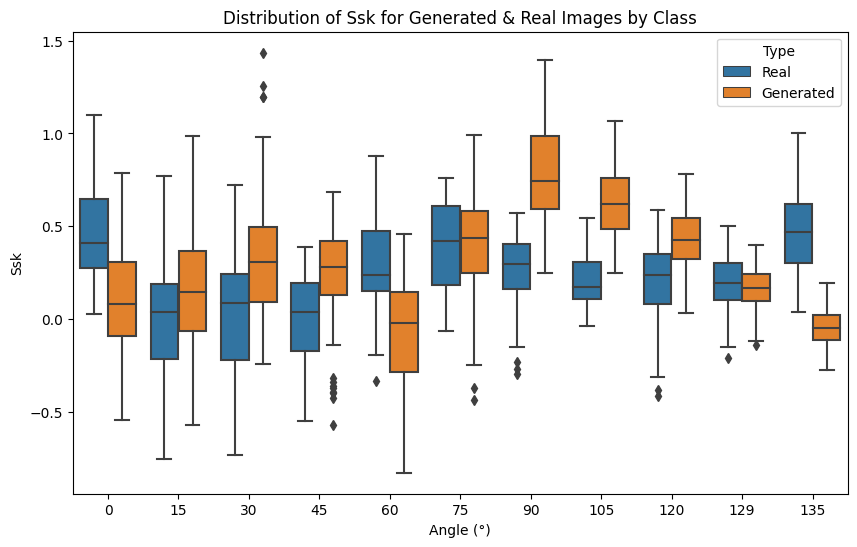

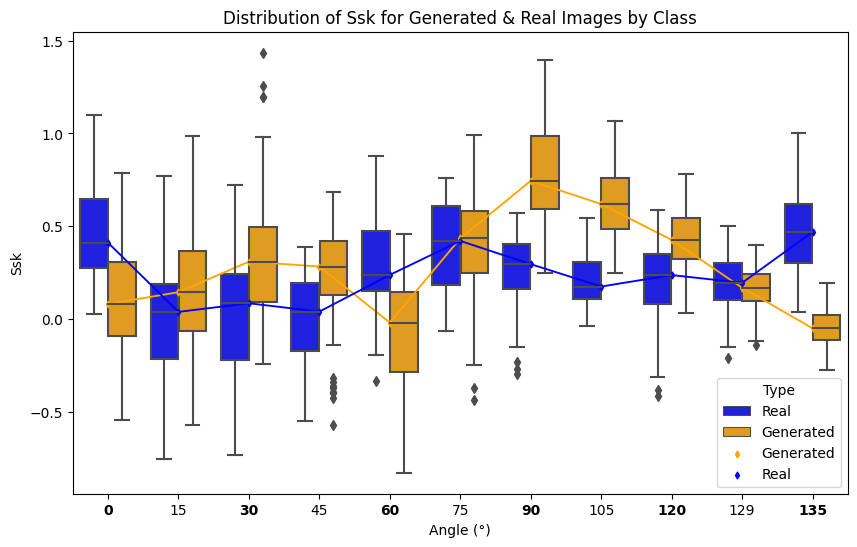

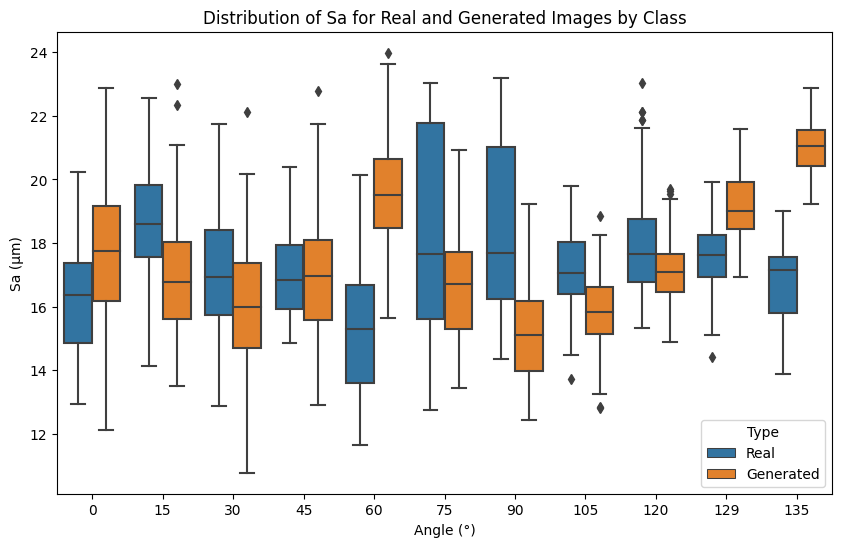

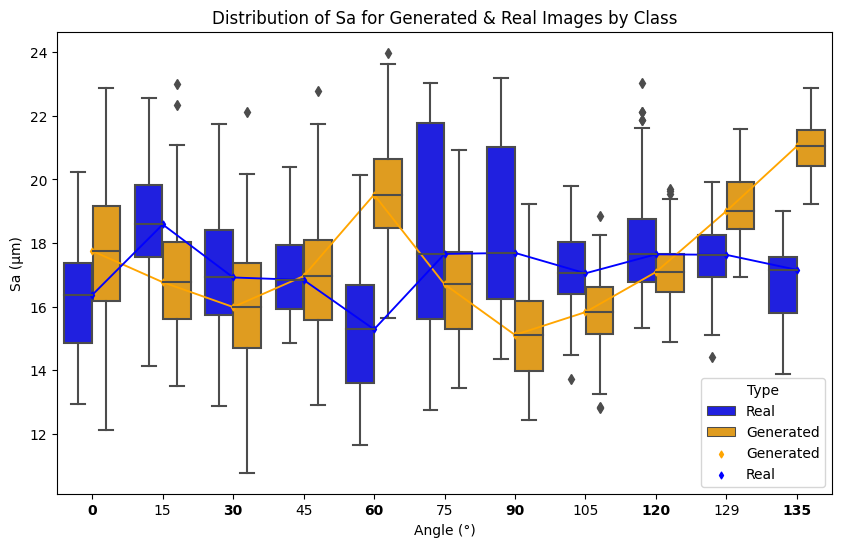

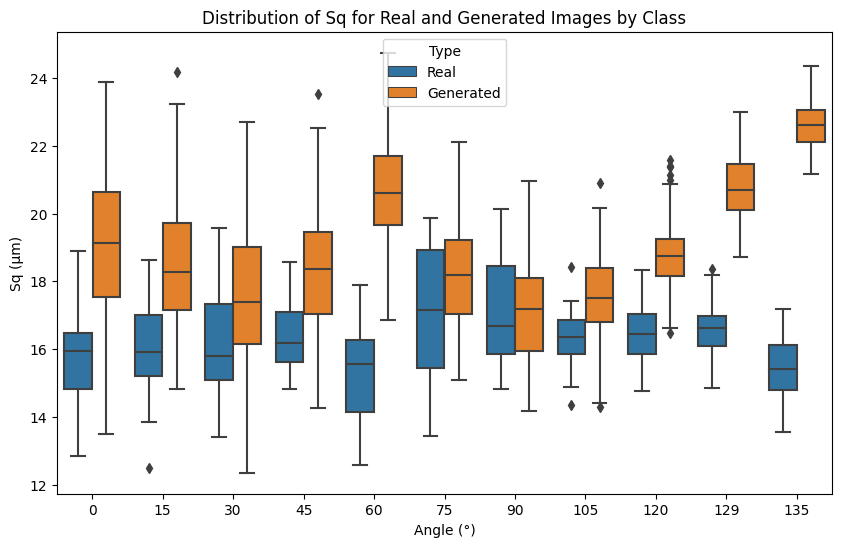

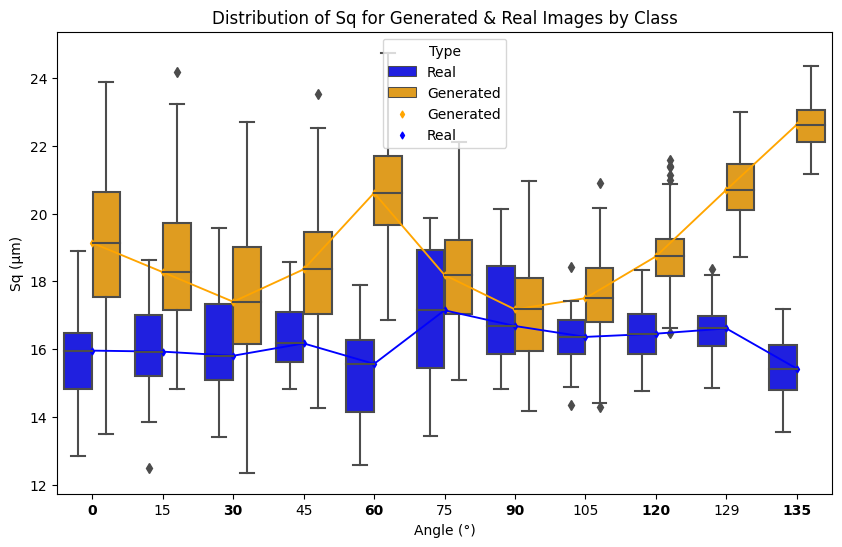

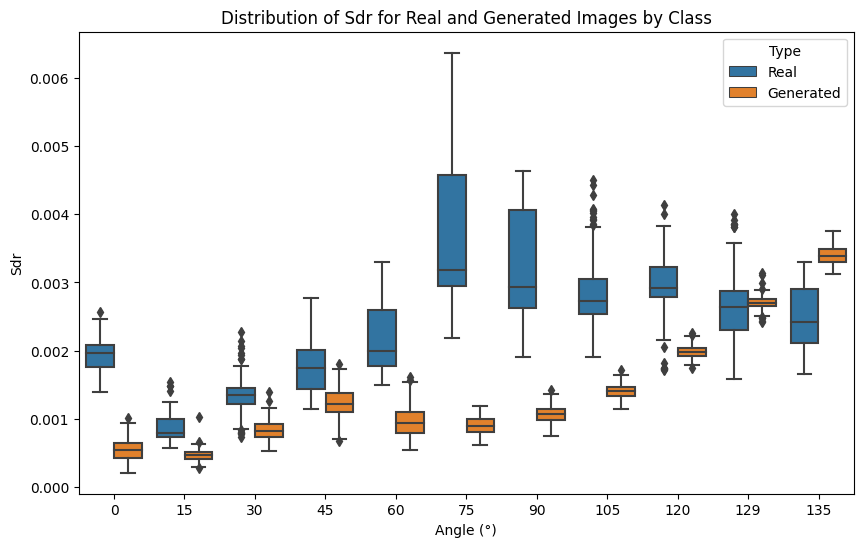

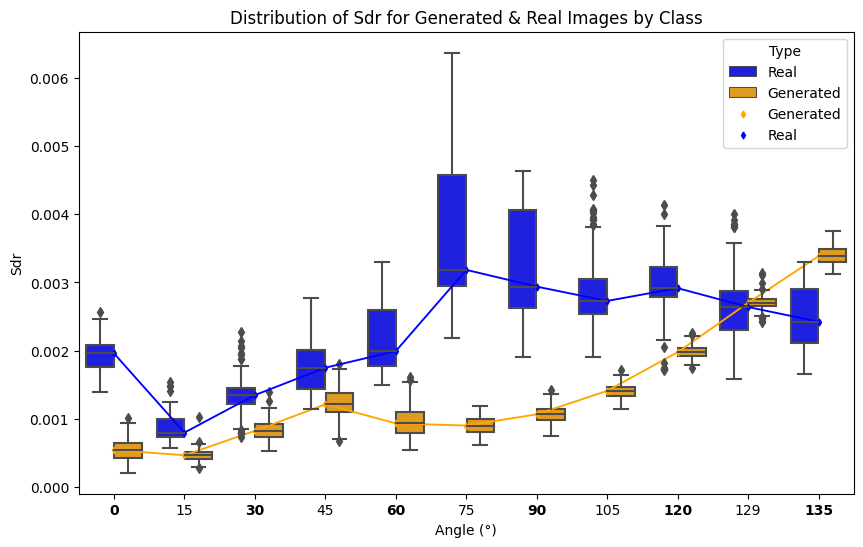

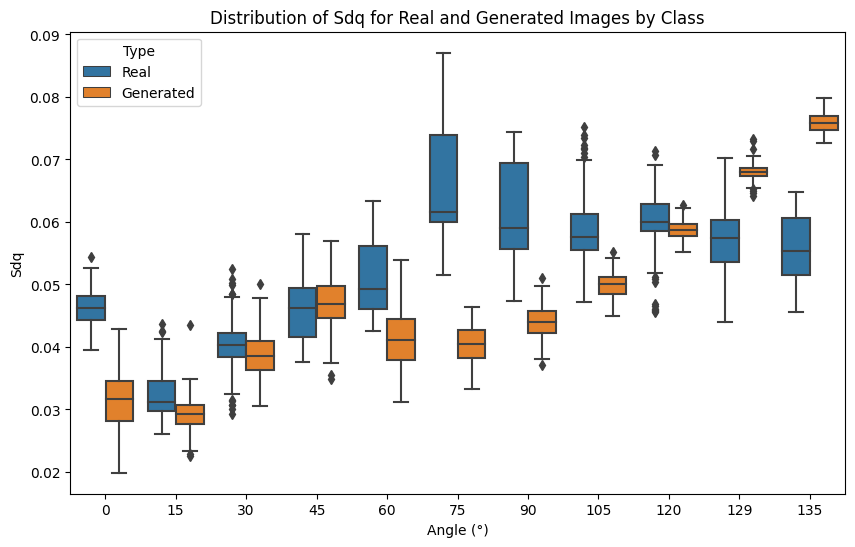

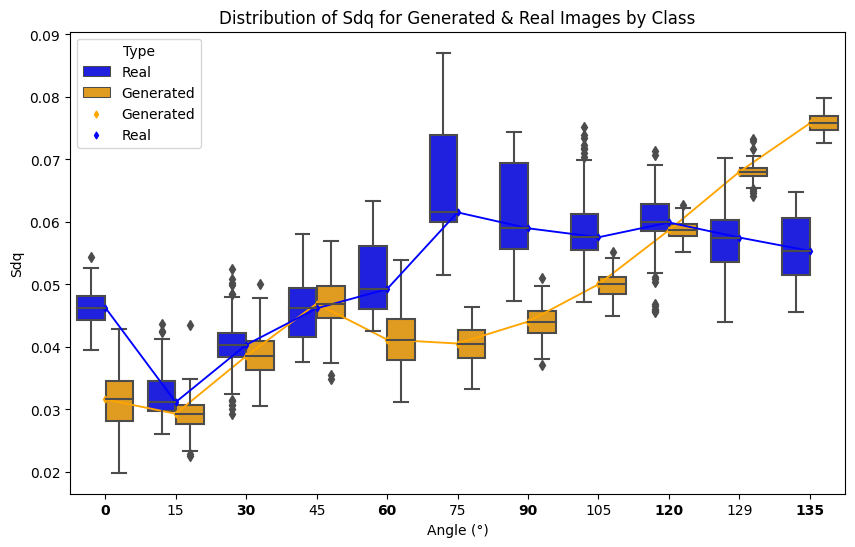

In [ ]:
# @title Plot Analysis graph --> OG
#################################
import seaborn as sns
import matplotlib.pyplot as plt

import pandas as pd

# create a mapping of class labels to the desired values
# class_mapping = {0: 0, 1: 30, 2: 60, 3: 90, 4: 120, 5: 135}
class_mapping = {0: 0,1:15, 2:30, 3:45, 4:60, 5:75, 6:90,7:105,8:120, 9:129, 10:135} #interpolation exercise

# create a list of classes for real and generated images, and map them to the desired values
classes_real = [class_mapping[int(item)] for sublist in [[i]*100 for i in range(11)] for item in sublist]
classes_generated = [class_mapping[int(item)] for sublist in [[i]*100 for i in range(11)] for item in sublist]

# the rest of your code remains unchanged

# flatten the Ssk arrays
Ssk_real_flat = [item for sublist in Ssk_Real_AllClass for item in sublist]
Ssk_generated_flat = [item for sublist in Ssk_Generated_AllClass for item in sublist]


#°
# create dataframes
df_real = pd.DataFrame({
    'Angle (°)': classes_real,
    'Ssk': Ssk_real_flat,
    'Type': ['Real']*1100  # 100 images for each of the 6 classes, 600 for trained class 1000 for all 
})

df_generated = pd.DataFrame({
    'Angle (°)': classes_generated,
    'Ssk': Ssk_generated_flat,
    'Type': ['Generated']*1100  # 100 images for each of the 6 classes, 600 for trained class 1000 for all 
})





# create dataframes

# concatenate the dataframes
df = pd.concat([df_real, df_generated])
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Ssk', hue='Type', data=df)
plt.title('Distribution of Ssk for Generated & Real Images by Class')
# plt.show()

#>>>>>>>>


# Define the colors for the lines and boxes
palette = {'Real': 'blue', 'Generated': 'orange'}

# Calculate the median values
medians = df.groupby(['Angle (°)', 'Type']).median().reset_index()

# Create the boxplot
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Ssk', hue='Type', data=df, palette=palette)

# Get the current axis
ax = plt.gca()

# Loop through each x-axis label
for label in ax.get_xticklabels():
    # If the label's text is in the list of angles to highlight, make it bold
    if int(label.get_text()) in [0,30,60,90,120,135]:
        label.set_fontweight('bold')

# Overlay a pointplot on the boxplot to connect median values
# Adjust the dodge parameter to align the lines with the boxes
sns.pointplot(x='Angle (°)', y='Ssk', hue='Type', data=medians, palette=palette, dodge=0, markers='d', scale=0.5, linestyles='-')

plt.title('Distribution of Ssk for Generated & Real Images by Class')
plt.show()


#>>>>>>>>



































# #################################


# flatten the Sa arrays
Sa_real_flat = [item for sublist in Sa_Real_AllClass for item in sublist]
Sa_generated_flat = [item for sublist in Sa_Generated_AllClass for item in sublist]

# create dataframes
df_real = pd.DataFrame({
    'Angle (°)': classes_real,
    'Sa (μm)': Sa_real_flat,
    'Type': ['Real']*1100  # 100 images for each of the 6 classes, 600 for trained class 1000 for all 
})

df_generated = pd.DataFrame({
    'Angle (°)': classes_generated,
    'Sa (μm)': Sa_generated_flat,
    'Type': ['Generated']*1100  # 100 images for each of the 6 classes, 600 for trained class 1000 for all 
})

# concatenate the dataframes
df = pd.concat([df_real, df_generated])
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sa (μm)', hue='Type', data=df)
plt.title('Distribution of Sa for Real and Generated Images by Class')
# plt.show()


#>>>>>>>>

# Get the current axis
# Define the colors for the lines and boxes
palette = {'Real': 'blue', 'Generated': 'orange'}

# Calculate the median values
medians = df.groupby(['Angle (°)', 'Type']).median().reset_index()

# Create the boxplot
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sa (μm)', hue='Type', data=df, palette=palette)

# Get the current axis
ax = plt.gca()

# Loop through each x-axis label
for label in ax.get_xticklabels():
    # If the label's text is in the list of angles to highlight, make it bold
    if int(label.get_text()) in [0,30,60,90,120,135]:
        label.set_fontweight('bold')

# Overlay a pointplot on the boxplot to connect median values
# Adjust the dodge parameter to align the lines with the boxes
sns.pointplot(x='Angle (°)', y='Sa (μm)', hue='Type', data=medians, palette=palette, dodge=0, markers='d', scale=0.5, linestyles='-')

plt.title('Distribution of Sa for Generated & Real Images by Class')
plt.show()


#>>>>>>>>







































# #################################


# flatten the Sq arrays
Sq_real_flat = [item for sublist in Sq_Real_AllClass for item in sublist]
Sq_generated_flat = [item for sublist in Sq_Generated_AllClass for item in sublist]

# create dataframes
df_real = pd.DataFrame({
    'Angle (°)': classes_real,
    'Sq (μm)': Sq_real_flat,
    'Type': ['Real']*1100  # 100 images for each of the 6 classes, 600 for trained class 1000 for all 
})

df_generated = pd.DataFrame({
    'Angle (°)': classes_generated,
    'Sq (μm)': Sq_generated_flat,
    'Type': ['Generated']*1100  # 100 images for each of the 6 classes, 600 for trained class 1000 for all 
})

# concatenate the dataframes
df = pd.concat([df_real, df_generated])
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sq (μm)', hue='Type', data=df)
plt.title('Distribution of Sq for Real and Generated Images by Class')
# plt.show()

#>>>>>>>>

# Get the current axis
# Define the colors for the lines and boxes
palette = {'Real': 'blue', 'Generated': 'orange'}

# Calculate the median values
medians = df.groupby(['Angle (°)', 'Type']).median().reset_index()

# Create the boxplot
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sq (μm)', hue='Type', data=df, palette=palette)

# Get the current axis
ax = plt.gca()

# Loop through each x-axis label
for label in ax.get_xticklabels():
    # If the label's text is in the list of angles to highlight, make it bold
    if int(label.get_text()) in [0,30,60,90,120,135]:
        label.set_fontweight('bold')

# Overlay a pointplot on the boxplot to connect median values
# Adjust the dodge parameter to align the lines with the boxes
sns.pointplot(x='Angle (°)', y='Sq (μm)', hue='Type', data=medians, palette=palette, dodge=0, markers='d', scale=0.5, linestyles='-')

plt.title('Distribution of Sq for Generated & Real Images by Class')
plt.show()

#>>>>>>>>


























#################################


# flatten the Sdr arrays
Sdr_real_flat = [item for sublist in Sdr_Real_AllClass for item in sublist]
Sdr_generated_flat = [item for sublist in Sdr_Generated_AllClass for item in sublist]

# create dataframes
df_real = pd.DataFrame({
    'Angle (°)': classes_real,
    'Sdr': Sdr_real_flat,
    'Type': ['Real']*1100  # 100 images for each of the 6 classes, 600 for trained class 1000 for all 
})

df_generated = pd.DataFrame({
    'Angle (°)': classes_generated,
    'Sdr': Sdr_generated_flat,
    'Type': ['Generated']*1100 # 100 images for each of the 6 classes, 600 for trained class 1000 for all 
})

# concatenate the dataframes
df = pd.concat([df_real, df_generated])
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sdr', hue='Type', data=df)
plt.title('Distribution of Sdr for Real and Generated Images by Class')
# plt.show()
#>>>>>>>>

# Get the current axis
# Define the colors for the lines and boxes
palette = {'Real': 'blue', 'Generated': 'orange'}

# Calculate the median values
medians = df.groupby(['Angle (°)', 'Type']).median().reset_index()

# Create the boxplot
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sdr', hue='Type', data=df, palette=palette)

# Get the current axis
ax = plt.gca()

# Loop through each x-axis label
for label in ax.get_xticklabels():
    # If the label's text is in the list of angles to highlight, make it bold
    if int(label.get_text()) in [0,30,60,90,120,135]:
        label.set_fontweight('bold')

# Overlay a pointplot on the boxplot to connect median values
# Adjust the dodge parameter to align the lines with the boxes
sns.pointplot(x='Angle (°)', y='Sdr', hue='Type', data=medians, palette=palette, dodge=0, markers='d', scale=0.5, linestyles='-')

plt.title('Distribution of Sdr for Generated & Real Images by Class')
plt.show()

#>>>>>>>>

























# #################################


# flatten the Sdq arrays
Sdq_real_flat = [item for sublist in Sdq_Real_AllClass for item in sublist]
Sdq_generated_flat = [item for sublist in Sdq_Generated_AllClass for item in sublist]

# create dataframes
df_real = pd.DataFrame({
    'Angle (°)': classes_real,
    'Sdq': Sdq_real_flat,
    'Type': ['Real']*1100  # 100 images for each of the 6 classes, 600 for trained class 1000 for all 
})

df_generated = pd.DataFrame({
    'Angle (°)': classes_generated,
    'Sdq': Sdq_generated_flat,
    'Type': ['Generated']*1100  # 100 images for each of the 6 classes, 600 for trained class 1000 for all 
})

# concatenate the dataframes
df = pd.concat([df_real, df_generated])
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sdq', hue='Type', data=df)
plt.title('Distribution of Sdq for Real and Generated Images by Class')
# plt.show()
#>>>>>>>>

# Get the current axis
# Define the colors for the lines and boxes
palette = {'Real': 'blue', 'Generated': 'orange'}

# Calculate the median values
medians = df.groupby(['Angle (°)', 'Type']).median().reset_index()

# Create the boxplot
plt.figure(figsize=(10,6))
sns.boxplot(x='Angle (°)', y='Sdq', hue='Type', data=df, palette=palette)

# Get the current axis
ax = plt.gca()

# Loop through each x-axis label
for label in ax.get_xticklabels():
    # If the label's text is in the list of angles to highlight, make it bold
    if int(label.get_text()) in [0,30,60,90,120,135]:
        label.set_fontweight('bold')

# Overlay a pointplot on the boxplot to connect median values
# Adjust the dodge parameter to align the lines with the boxes
sns.pointplot(x='Angle (°)', y='Sdq', hue='Type', data=medians, palette=palette, dodge=0, markers='d', scale=0.5, linestyles='-')

plt.title('Distribution of Sdq for Generated & Real Images by Class')
plt.show()


#>>>>>>>>

94/94 [==============================] - 2s 19ms/step


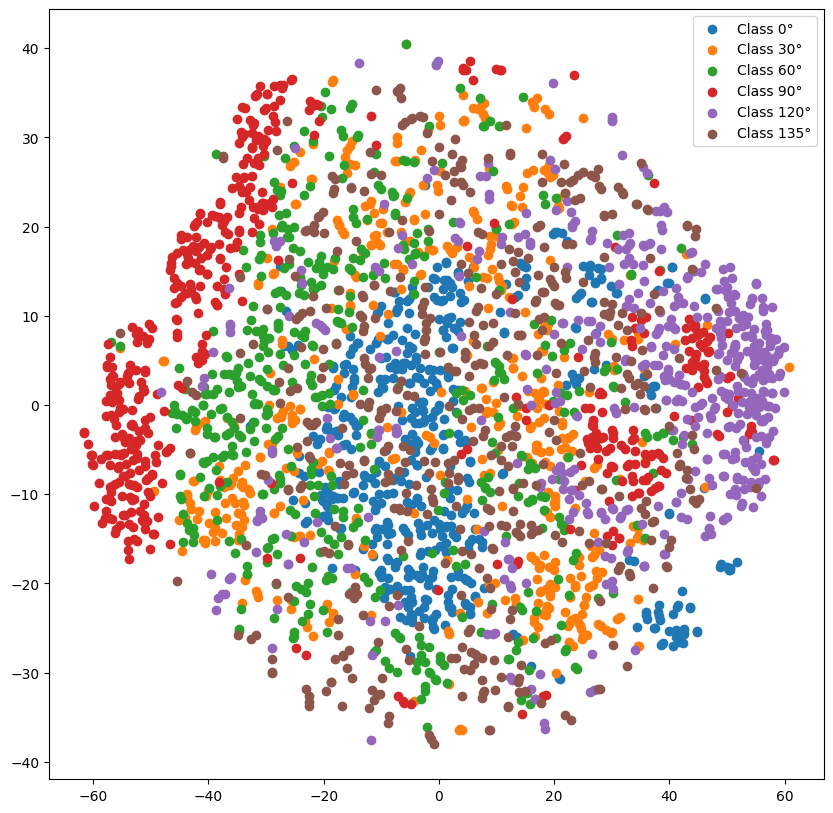

In [ ]:
# @title visualisation (t-SNE)


import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import tensorflow as tf

# 1. Sample points from the latent space
n_samples_per_class = 500  # number of samples to generate per class
n_classes = 6
latent_dim = 100  # size of the latent space
latent_samples = np.random.normal(0, 1, (n_samples_per_class * n_classes, latent_dim))

labelClass = ['0°', '30°', '60°', '90°', '120°', '135°']

# 2. Generate class labels
labels = np.zeros((n_samples_per_class * n_classes, n_classes))
for i in range(n_classes):
    labels[i * n_samples_per_class:(i + 1) * n_samples_per_class, i] = 1

# 3. Generate outputs from the generator
generated_samples = generator.predict([latent_samples, labels])

# Flatten the images for use with t-SNE
# This assumes the generator output is an image and may not be necessary
# depending on your generator's output
generated_samples = generated_samples.reshape((n_samples_per_class * n_classes, -1))

# 4. Apply t-SNE to the generated outputs
tsne = TSNE(n_components=2)
X_tsne = tsne.fit_transform(generated_samples)

# Visualize the t-SNE output with different colors for each class
plt.figure(figsize=(10, 10))
for i in range(n_classes):
    plt.scatter(X_tsne[i * n_samples_per_class:(i + 1) * n_samples_per_class, 0], 
                X_tsne[i * n_samples_per_class:(i + 1) * n_samples_per_class, 1], 
                label=f'Class {labelClass[i]}')
plt.legend()
plt.show()


In [ ]:
# @title visualisation (PCA)


# import numpy as np
# from sklearn.decomposition import PCA
# import matplotlib.pyplot as plt
# import tensorflow as tf

# # 1. Sample points from the latent space
# n_samples_per_class = 500  # number of samples to generate per class
# n_classes = 6
# latent_dim = 100  # size of the latent space
# latent_samples = np.random.normal(0, 1, (n_samples_per_class * n_classes, latent_dim))

# labelClass = ['0°', '30°', '60°', '90°', '120°', '135°']

# # 2. Generate class labels
# labels = np.zeros((n_samples_per_class * n_classes, n_classes))
# for i in range(n_classes):
#     labels[i * n_samples_per_class:(i + 1) * n_samples_per_class, i] = 1

# # 3. Generate outputs from the generator
# generated_samples = generator.predict([latent_samples, labels])

# # Flatten the images for use with PCA
# # This assumes the generator output is an image and may not be necessary
# # depending on your generator's output
# generated_samples = generated_samples.reshape((n_samples_per_class * n_classes, -1))

# # 4. Apply PCA to the generated outputs
# pca = PCA(n_components=2)
# X_pca = pca.fit_transform(generated_samples)

# # Visualize the PCA output with different colors for each class
# plt.figure(figsize=(10, 10))
# for i in range(n_classes):
#     plt.scatter(X_pca[i * n_samples_per_class:(i + 1) * n_samples_per_class, 0], 
#                 X_pca[i * n_samples_per_class:(i + 1) * n_samples_per_class, 1], 
#                 label=f'Class {labelClass[i]}')
# plt.legend()
# plt.show()


94/94 [==============================] - 1s 15ms/step


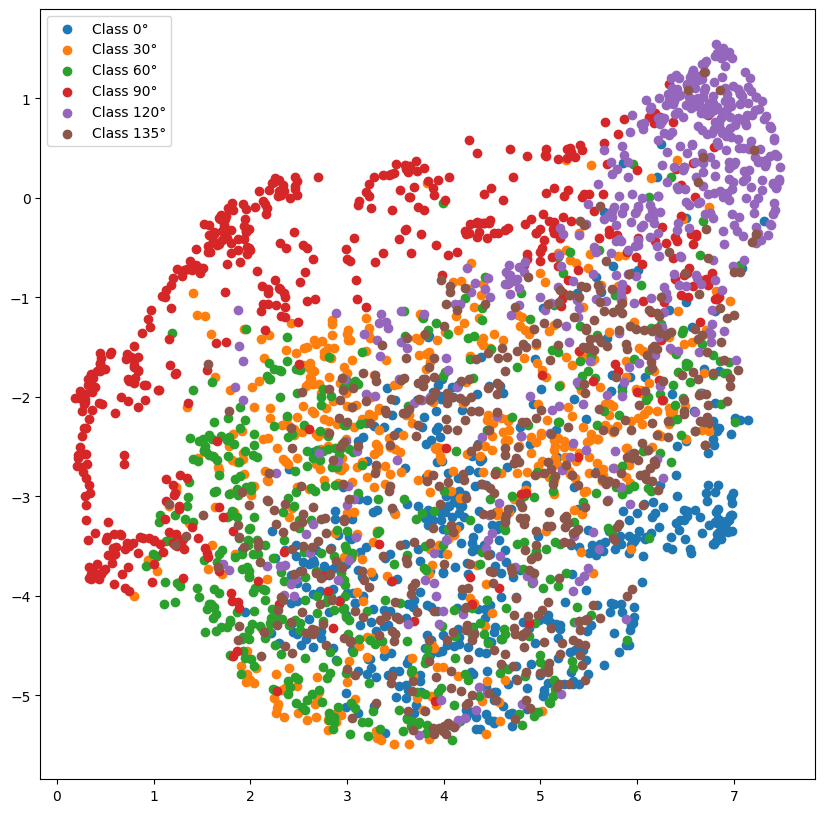

In [ ]:
# @title visualisation (u-MAP)

# !pip install umap-learn

import numpy as np
import umap
import matplotlib.pyplot as plt
import tensorflow as tf

# 1. Sample points from the latent space
n_samples_per_class = 500  # number of samples to generate per class
n_classes = 6
latent_dim = 100  # size of the latent space
latent_samples = np.random.normal(0, 1, (n_samples_per_class * n_classes, latent_dim))

labelClass = ['0°', '30°', '60°', '90°', '120°', '135°']

# 2. Generate class labels
labels = np.zeros((n_samples_per_class * n_classes, n_classes))
for i in range(n_classes):
    labels[i * n_samples_per_class:(i + 1) * n_samples_per_class, i] = 1

# 3. Generate outputs from the generator
generated_samples = generator.predict([latent_samples, labels])

# Flatten the images for use with UMAP
# This assumes the generator output is an image and may not be necessary
# depending on your generator's output
generated_samples = generated_samples.reshape((n_samples_per_class * n_classes, -1))

# 4. Apply UMAP to the generated outputs
reducer = umap.UMAP()
X_umap = reducer.fit_transform(generated_samples)

# Visualize the UMAP output with different colors for each class
plt.figure(figsize=(10, 10))
for i in range(n_classes):
    plt.scatter(X_umap[i * n_samples_per_class:(i + 1) * n_samples_per_class, 0], 
                X_umap[i * n_samples_per_class:(i + 1) * n_samples_per_class, 1], 
                label=f'Class {labelClass[i]}')
plt.legend()
plt.show()


In [ ]:
# @title - [Not good] Plot based on Ssk with t-SNE

# #TO CHECK -- Based on Ssk



# import numpy as np
# import umap
# import matplotlib.pyplot as plt
# import tensorflow as tf
# from scipy.stats import skew

# # 1. Sample points from the latent space
# n_samples_per_class = 500  # number of samples to generate per class
# n_classes = 6
# latent_dim = 100  # size of the latent space
# latent_samples = np.random.normal(0, 1, (n_samples_per_class * n_classes, latent_dim))

# labelClass = ['0°', '30°', '60°', '90°', '120°', '135°']

# # 2. Generate class labels
# labels = np.zeros((n_samples_per_class * n_classes, n_classes))
# for i in range(n_classes):
#     labels[i * n_samples_per_class:(i + 1) * n_samples_per_class, i] = 1

# # 3. Generate outputs from the generator
# generated_samples = generator.predict([latent_samples, labels])

# # Flatten the images for use with UMAP
# # This assumes the generator output is an image and may not be necessary
# # depending on your generator's output
# generated_samples = generated_samples.reshape((n_samples_per_class * n_classes, -1))

# # Calculate Ssk and Rq
# ssk = np.array([skew(sample) for sample in generated_samples])
# rq = np.array([np.sqrt(np.mean(np.square(sample))) for sample in generated_samples])

# # Add Ssk and Rq as additional features
# expanded_samples = np.column_stack((generated_samples, ssk, rq))

# # 4. Apply UMAP to the generated outputs
# reducer = umap.UMAP()
# X_umap = reducer.fit_transform(expanded_samples)

# # # Visualize the UMAP output with different colors for each class
# # plt.figure(figsize=(10, 10))
# # for i in range(n_classes):
# #     plt.scatter(X_umap[i * n_samples_per_class:(i + 1) * n_samples_per_class, 0], 
# #                 X_umap[i * n_samples_per_class:(i + 1) * n_samples_per_class, 1], 
# #                 label=f'Class {labelClass[i]}')
# # plt.legend()
# # plt.show()





# # 4. Apply t-SNE to the generated outputs
# tsne = TSNE(n_components=2)
# X_tsne = tsne.fit_transform(expanded_samples)

# # Visualize the t-SNE output with different colors for each class
# plt.figure(figsize=(10, 10))
# for i in range(n_classes):
#     plt.scatter(X_tsne[i * n_samples_per_class:(i + 1) * n_samples_per_class, 0], 
#                 X_tsne[i * n_samples_per_class:(i + 1) * n_samples_per_class, 1], 
#                 label=f'Class {labelClass[i]}')
# plt.legend()
# plt.show()




In [ ]:
# @title - [Not good] Plot based on Ssk, Rq, and Kurtosis with t-SNE. data is flattened

# import matplotlib.pyplot as plt

# # 1. Sample points from the latent space
# n_samples_per_class = 500  # number of samples to generate per class
# n_classes = 6
# latent_dim = 100  # size of the latent space
# latent_samples = np.random.normal(0, 1, (n_samples_per_class * n_classes, latent_dim))

# labelClass = ['0°', '30°', '60°', '90°', '120°', '135°']

# # 2. Generate class labels
# labels = np.zeros((n_samples_per_class * n_classes, n_classes))
# for i in range(n_classes):
#     labels[i * n_samples_per_class:(i + 1) * n_samples_per_class, i] = 1

# # 3. Generate outputs from the generator
# generated_samples = generator.predict([latent_samples, labels])

# # Calculate Ssk and Rq values
# ssk_values = np.array([skew(sample.flatten()) for sample in generated_samples])  # replace with Ssk

# sku_values = np.array([kurtosis(sample.flatten()) for sample in generated_samples]) #replace with Kurtosis
# rq_values = np.array([np.sqrt(np.mean(np.square(sample))) for sample in generated_samples])  # replace with  Rq values

# plt.figure(figsize=(10, 10))


# # Add Ssk and Rq as additional features
# expanded_samples = np.concatenate(ssk_values, sku_values, rq_values)



# # 4. Apply t-SNE to the generated outputs
# tsne = TSNE(n_components=2)
# X_tsne = tsne.fit_transform(expanded_samples)

# # Visualize the t-SNE output with different colors for each class
# plt.figure(figsize=(10, 10))
# for i in range(n_classes):
#     plt.scatter(X_tsne[i * n_samples_per_class:(i + 1) * n_samples_per_class, 0], 
#                 X_tsne[i * n_samples_per_class:(i + 1) * n_samples_per_class, 1], 
#                 label=f'Class {labelClass[i]}')
# plt.legend()
# plt.show()




In [ ]:
generator.save('drive/MyDrive/GAN/GEN_cGAN_0-135_955E.h5')
discriminator.save('drive/MyDrive/GAN/DIS_cGAN_0-135_955E.h5')

In [ ]:
# @title [OLD] - TO Test run based on direct class input --> this is changed to latent space interpolation instead

# generator = tf.keras.models.load_model('drive/MyDrive/GAN/GEN_cGAN_0-135_955E.h5')
# discriminator = tf.keras.models.load_model('drive/MyDrive/GAN/DIS_cGAN_0-135_955E.h5')


# noise = tf.random.normal([1, 100])
# Label = 0  # Choose a label to generate samples from

# for i in range(6):
#   label_sample = tf.one_hot([i], depth=6)  # Choose a label to generate samples from

#   generated_image = generator([noise, label_sample], training=False)
#   generated_image = (generated_image[0, :, :, 0] * 32768.0 + 32768.0).numpy().astype(np.uint16)
#   plt.imshow(generated_image, cmap='gray')
#   plt.show()

In [ ]:
# @title [OLD] - To run the prediction 0-136 But wrong

# '''
# TO RUN THE PREDICTION, ON INTERPOLATED LATENT SPACE

# '''
# import tensorflow as tf
# from tensorflow.keras.layers import Embedding, multiply
# from tensorflow import concat
# from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Dropout, Concatenate, Conv2D, Conv2DTranspose, LeakyReLU, BatchNormalization
# from tensorflow.keras.models import Sequential, Model
# from tensorflow.keras.optimizers import Adam
# import numpy as np
# import glob
# import imageio
# import matplotlib.pyplot as plt
# import os
# from keras.layers import Activation
# import math





# def interpolate_classes(generator, class1, class2, steps):
#     # Create a batch of latent vectors. We'll generate one sample for each step.
#     latent = tf.random.normal([steps, 100])

#     # Create a vector of class labels, changing linearly from class1 to class2.
#     interpolated_labels = np.zeros((steps, 6))  # Change this to match your number of classes
#     for i in range(steps):
#         alpha = i / (steps - 1)  # alpha goes from 0 to 1 as i goes from 0 to steps-1
#         interpolated_labels[i, :] = (1 - alpha) * class1 + alpha * class2

#     # Use the generator to generate images for each combination of latent vector and class label.
#     generated_images = generator([latent, interpolated_labels])

#     return generated_images


# ## Load The Generator - Comment if not needed
# # generator = tf.keras.models.load_model('drive/MyDrive/GAN/GEN_cGAN_0_1500E.h5')
# # discriminator = tf.keras.models.load_model('drive/MyDrive/GAN/DIS_cGAN_0_1500E.h5')


# # Define the classes that the model was trained on
# trained_classes = [0, 30, 60, 90, 120, 135]



# trained_classes_one_hot = [tf.one_hot([i], depth=6)[0] for i in trained_classes]

# # Define the classes you want to generate, this case is 0-13
# desired_classes = list(range(135))

# # Generate an image for each desired class
# for desired_class in desired_classes:
#     # Find the two closest trained classes
#     closest_classes = sorted(trained_classes, key=lambda x: abs(x - desired_class))[:2]
#     class1, class2 = closest_classes

#     # Find the corresponding one-hot encoded classes
#     class1_one_hot = trained_classes_one_hot[trained_classes.index(class1)]
#     class2_one_hot = trained_classes_one_hot[trained_classes.index(class2)]

#     # Calculate the interpolation coefficient
#     total_diff = class2 - class1
#     desired_diff = desired_class - class1
#     alpha = desired_diff / total_diff

#     # Interpolate between the two closest trained classes
#     interpolated_class = (1 - alpha) * class1_one_hot + alpha * class2_one_hot


#     # Generate and display the image
#     interpolated_images = generator.predict([np.random.normal(0, 1, (1, 100)), np.array([interpolated_class])])
#     generated_image = interpolated_images[0]
#     generated_image = (generated_image[:, :, 0] * 32768.0 + 32768.0).astype(np.uint16)

#     output_dir = ''
#     # Display The Image
#     plt.imshow(generated_image, cmap='gray')
#     plt.title(f'Generated image for class {desired_class}')
#     plt.show()

#     #Save The Image

#     # imageio.imwrite(os.path.join(output_dir, f'{desired_class}.png'), generated_image)



0.0
1/1 [==============================] - 0s 159ms/step


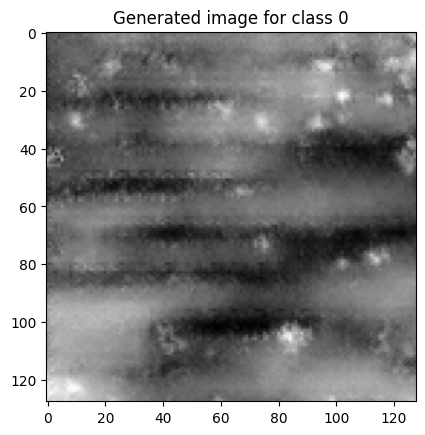

0.03333333333333333
1/1 [==============================] - 0s 20ms/step


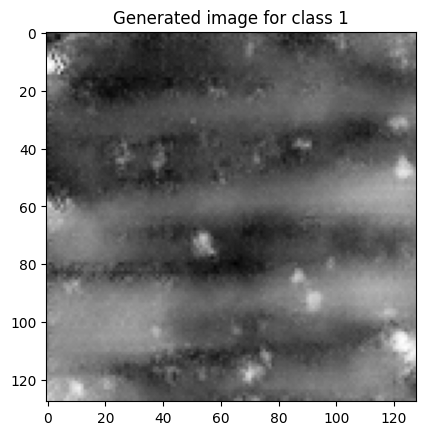

0.06666666666666667
1/1 [==============================] - 0s 27ms/step


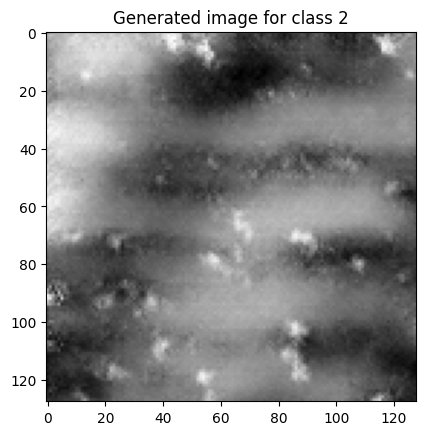

0.1
1/1 [==============================] - 0s 19ms/step


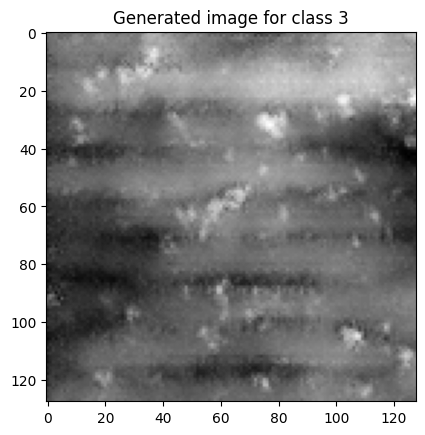

0.13333333333333333
1/1 [==============================] - 0s 20ms/step


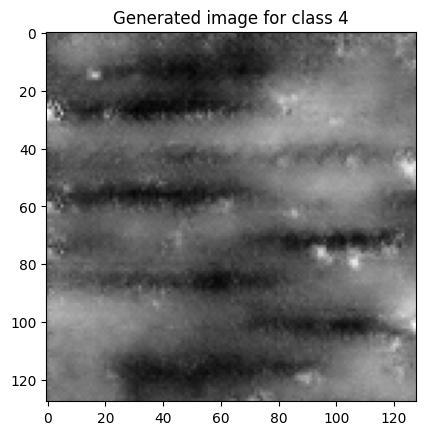

0.16666666666666666
1/1 [==============================] - 0s 23ms/step


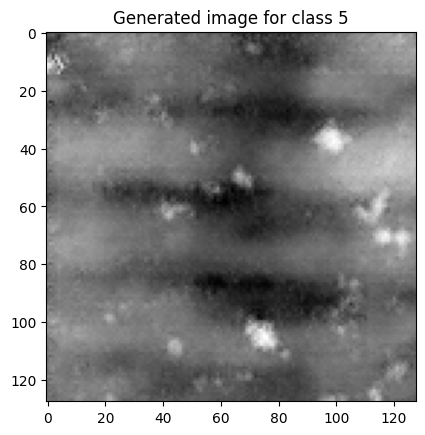

0.2
1/1 [==============================] - 0s 22ms/step


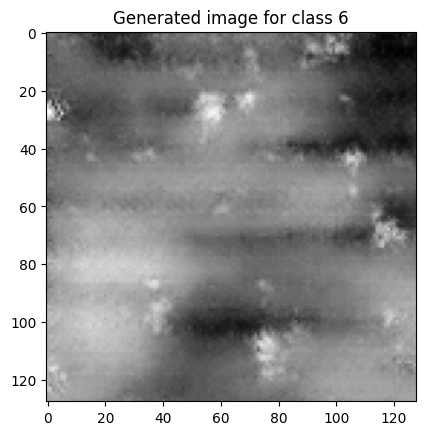

0.23333333333333334
1/1 [==============================] - 0s 23ms/step


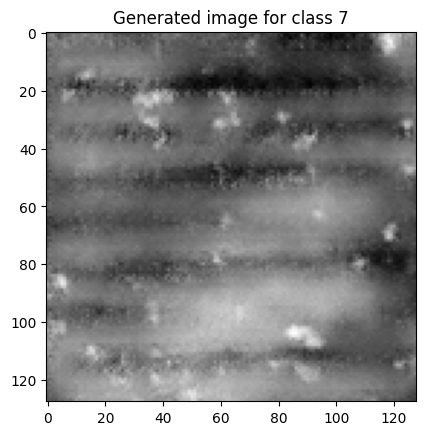

0.26666666666666666
1/1 [==============================] - 0s 23ms/step


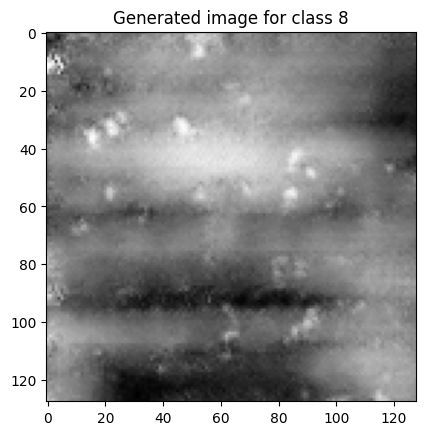

0.3
1/1 [==============================] - 0s 20ms/step


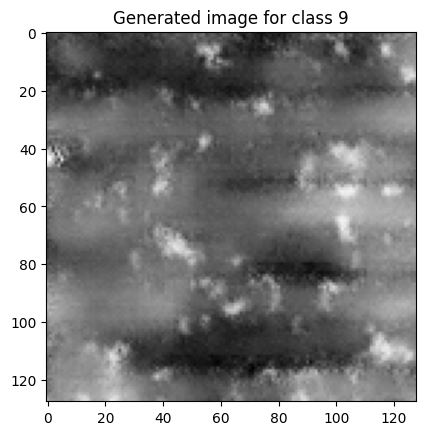

0.3333333333333333
1/1 [==============================] - 0s 21ms/step


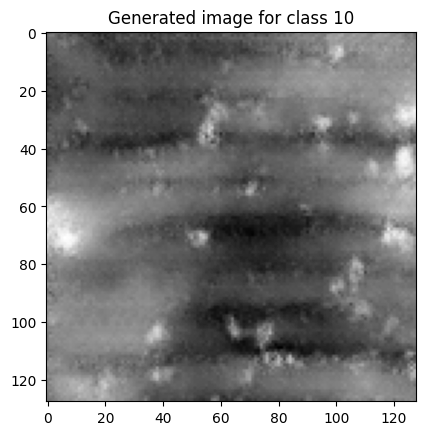

0.36666666666666664
1/1 [==============================] - 0s 19ms/step


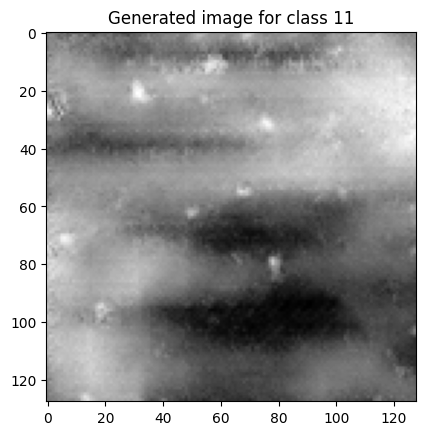

0.4
1/1 [==============================] - 0s 20ms/step


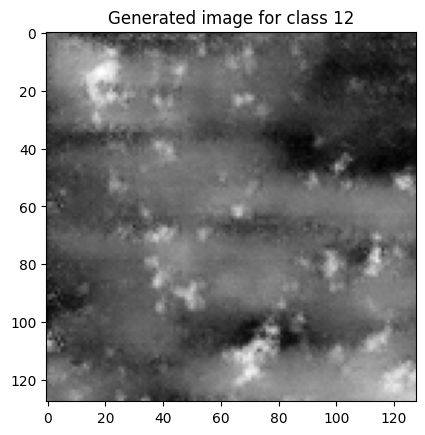

0.43333333333333335
1/1 [==============================] - 0s 19ms/step


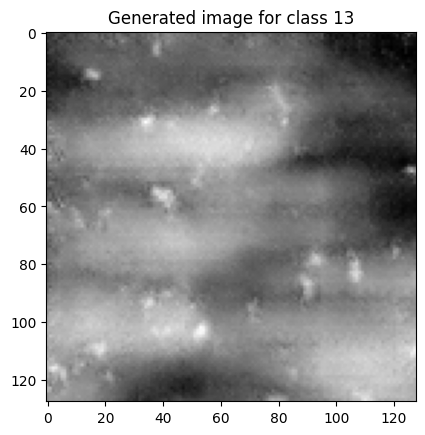

0.4666666666666667
1/1 [==============================] - 0s 20ms/step


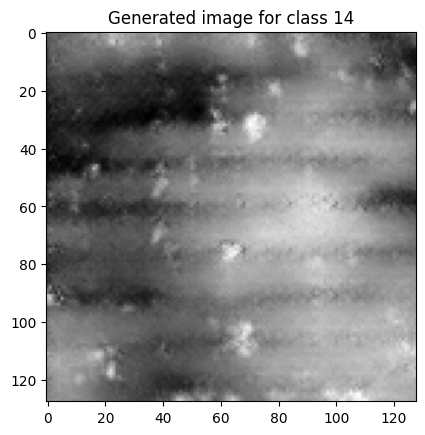

0.5
1/1 [==============================] - 0s 22ms/step


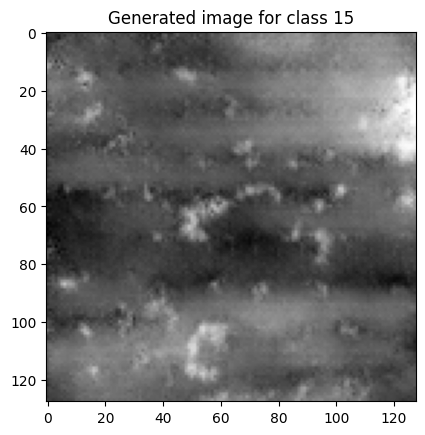

0.5333333333333333
1/1 [==============================] - 0s 19ms/step


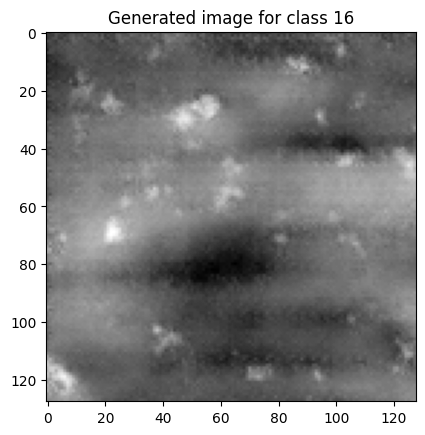

0.5666666666666667
1/1 [==============================] - 0s 21ms/step


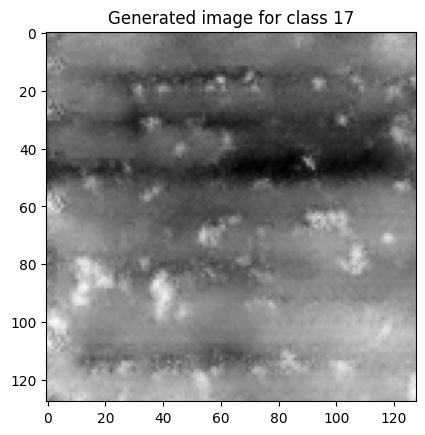

0.6
1/1 [==============================] - 0s 27ms/step


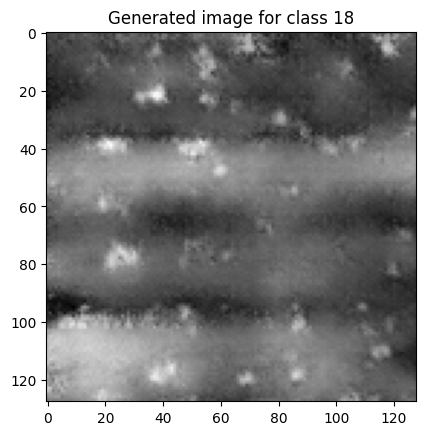

0.6333333333333333
1/1 [==============================] - 0s 27ms/step


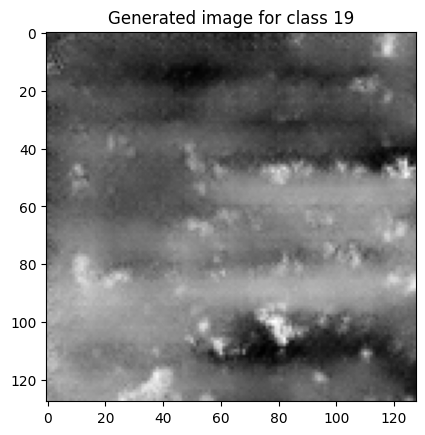

0.6666666666666666
1/1 [==============================] - 0s 22ms/step


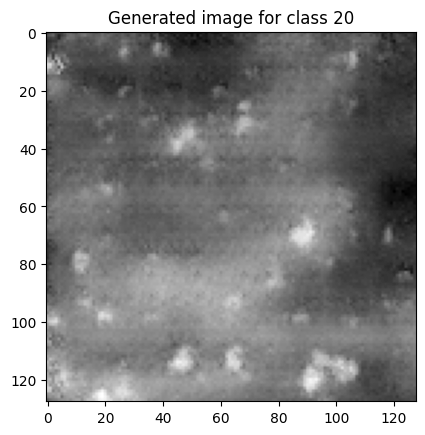

0.7
1/1 [==============================] - 0s 25ms/step


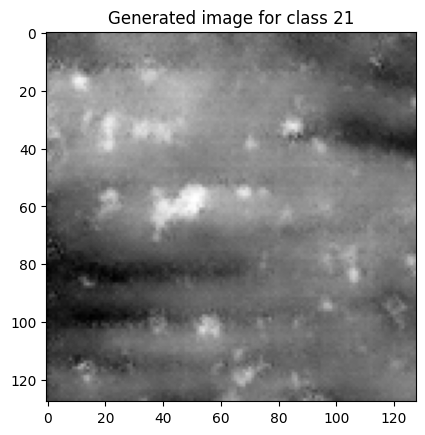

0.7333333333333333
1/1 [==============================] - 0s 24ms/step


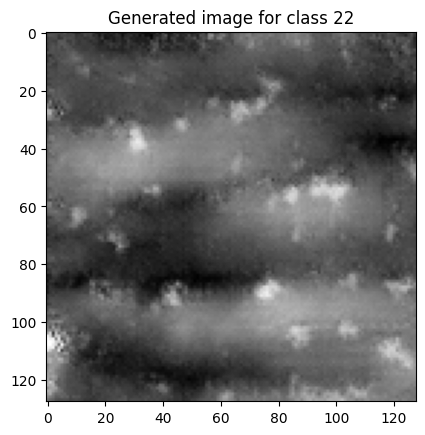

0.7666666666666666
1/1 [==============================] - 0s 23ms/step


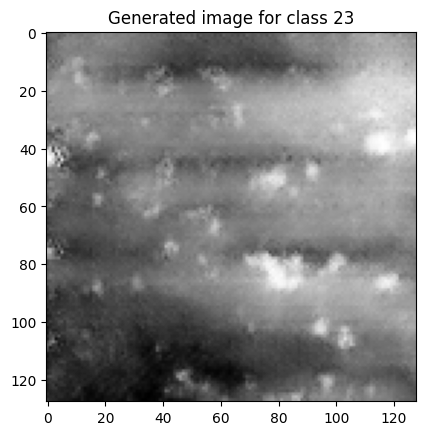

0.8
1/1 [==============================] - 0s 20ms/step


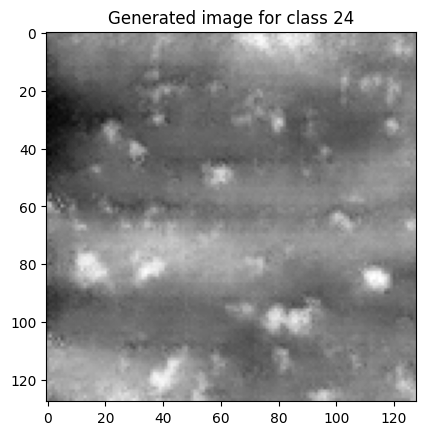

0.8333333333333334
1/1 [==============================] - 0s 28ms/step


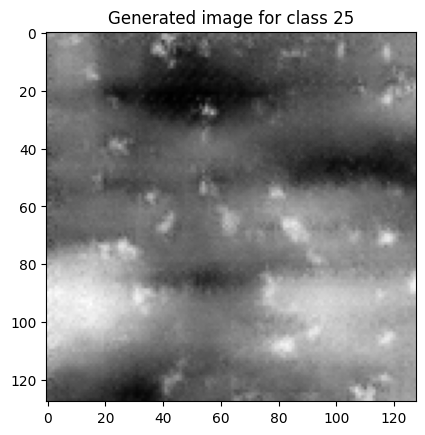

0.8666666666666667
1/1 [==============================] - 0s 42ms/step


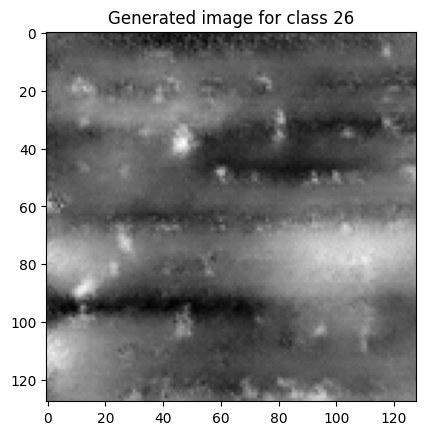

0.9
1/1 [==============================] - 0s 54ms/step


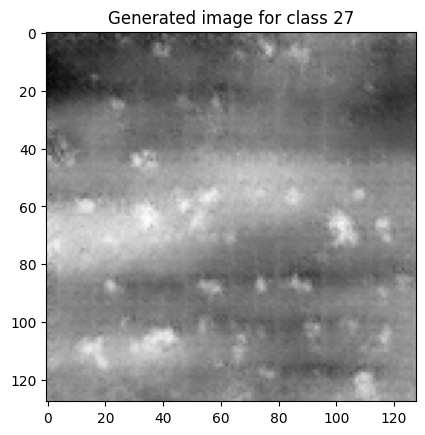

0.9333333333333333
1/1 [==============================] - 0s 34ms/step


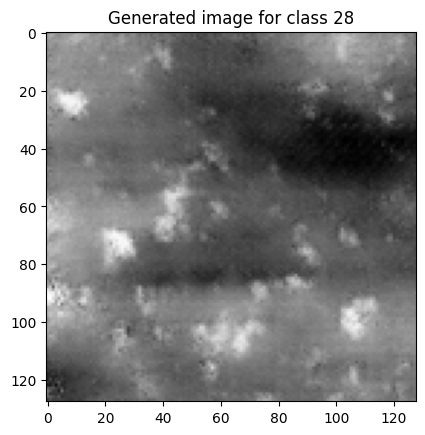

0.9666666666666667
1/1 [==============================] - 0s 57ms/step


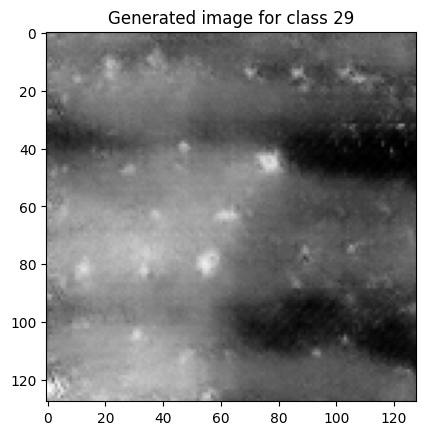

1.0
1/1 [==============================] - 0s 55ms/step


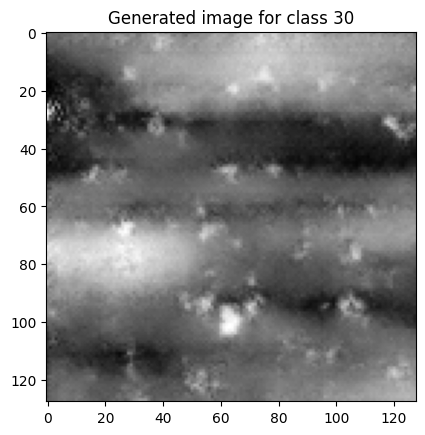

1.0333333333333334
1/1 [==============================] - 0s 41ms/step


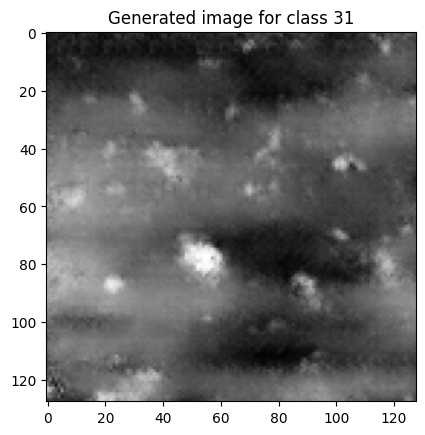

1.0666666666666667
1/1 [==============================] - 0s 46ms/step


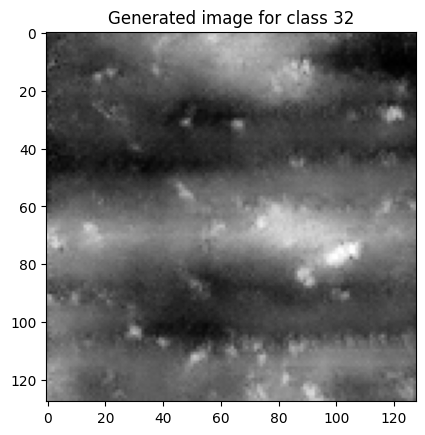

1.1
1/1 [==============================] - 0s 25ms/step


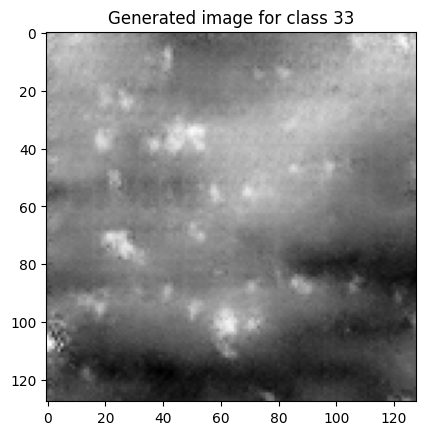

1.1333333333333333
1/1 [==============================] - 0s 27ms/step


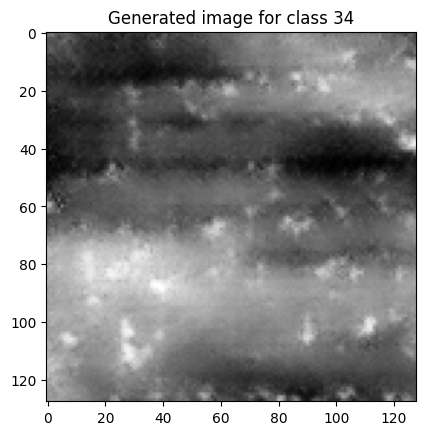

1.1666666666666667
1/1 [==============================] - 0s 29ms/step


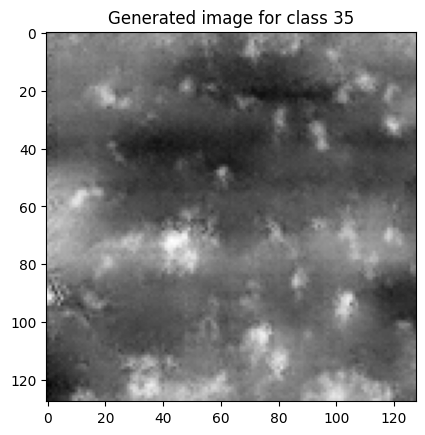

1.2
1/1 [==============================] - 0s 25ms/step


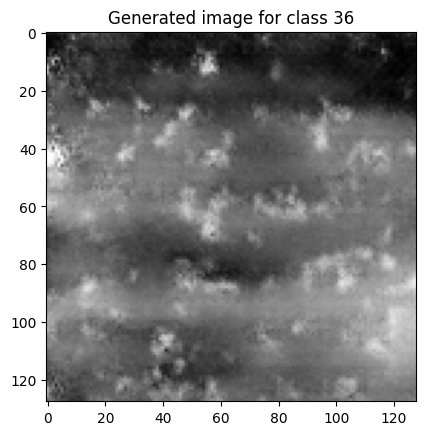

1.2333333333333334
1/1 [==============================] - 0s 29ms/step


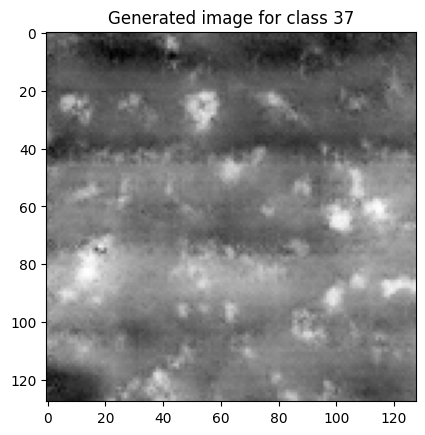

1.2666666666666666
1/1 [==============================] - 0s 30ms/step


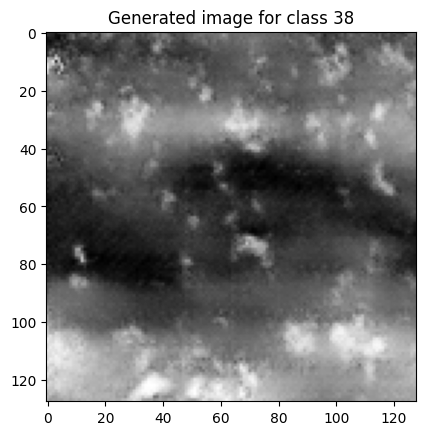

1.3
1/1 [==============================] - 0s 28ms/step


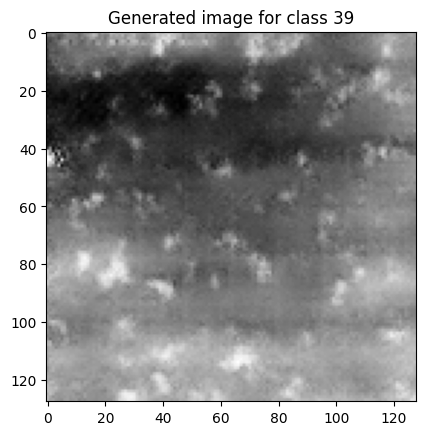

1.3333333333333333
1/1 [==============================] - 0s 29ms/step


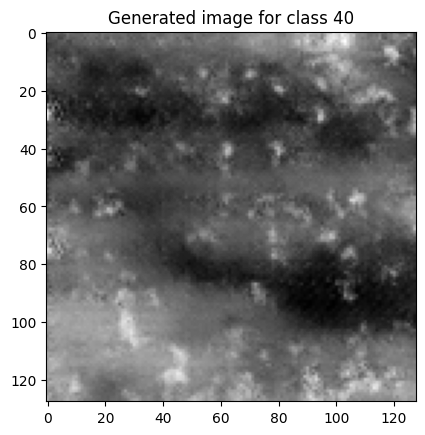

1.3666666666666667
1/1 [==============================] - 0s 31ms/step


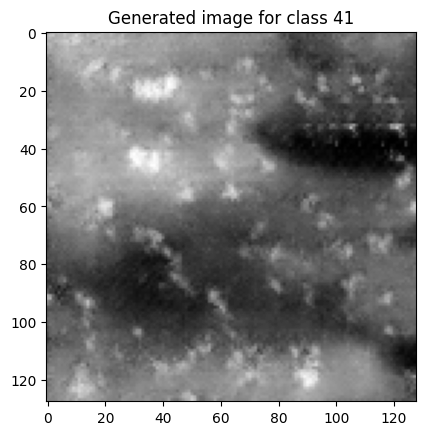

1.4
1/1 [==============================] - 0s 27ms/step


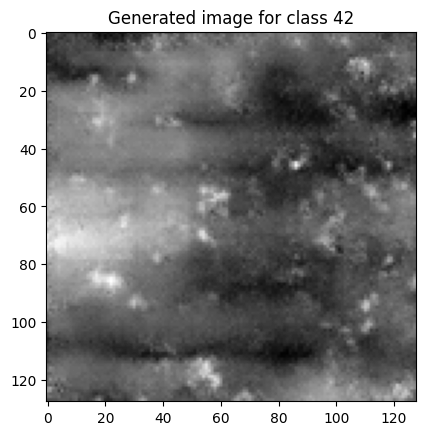

1.4333333333333333
1/1 [==============================] - 0s 30ms/step


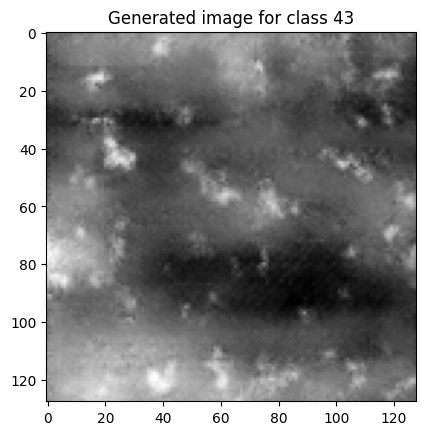

1.4666666666666668
1/1 [==============================] - 0s 25ms/step


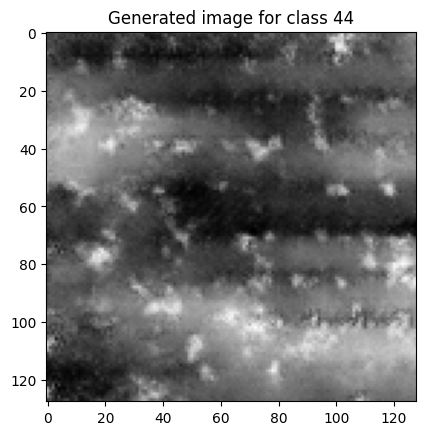

1.5
1/1 [==============================] - 0s 29ms/step


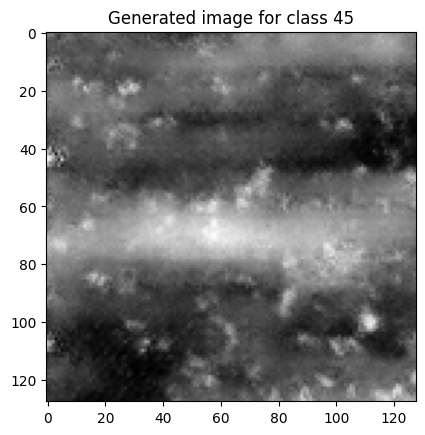

1.5333333333333332
1/1 [==============================] - 0s 30ms/step


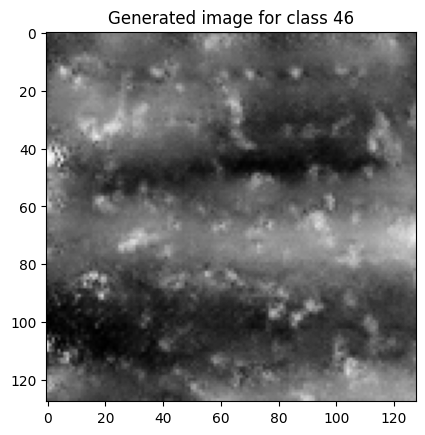

1.5666666666666667
1/1 [==============================] - 0s 35ms/step


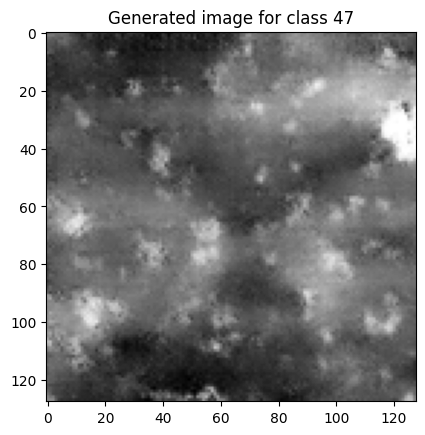

1.6
1/1 [==============================] - 0s 38ms/step


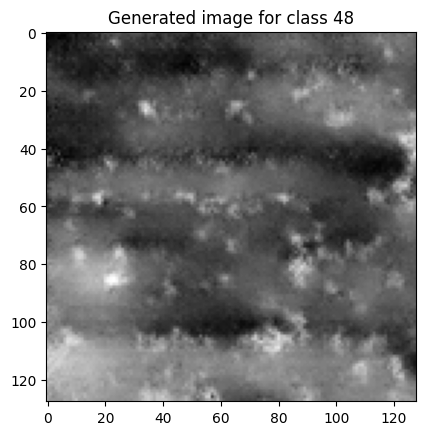

1.6333333333333333
1/1 [==============================] - 0s 28ms/step


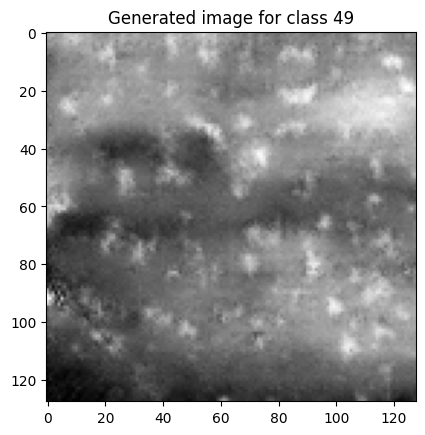

1.6666666666666665
1/1 [==============================] - 0s 27ms/step


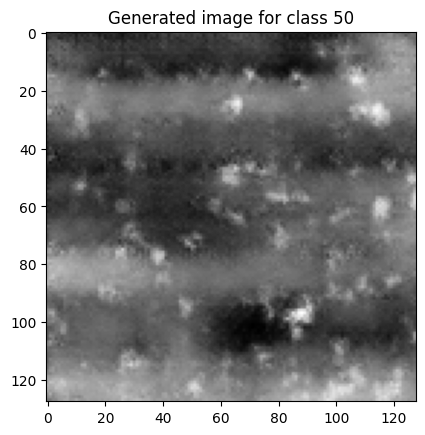

1.7
1/1 [==============================] - 0s 25ms/step


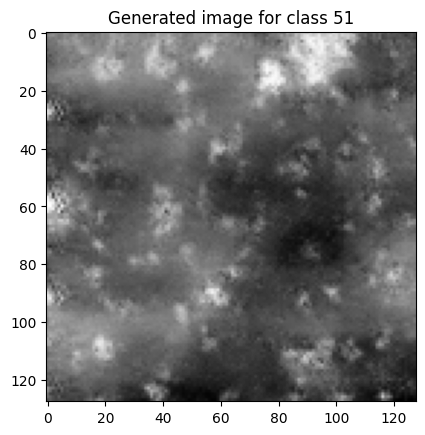

1.7333333333333334
1/1 [==============================] - 0s 27ms/step


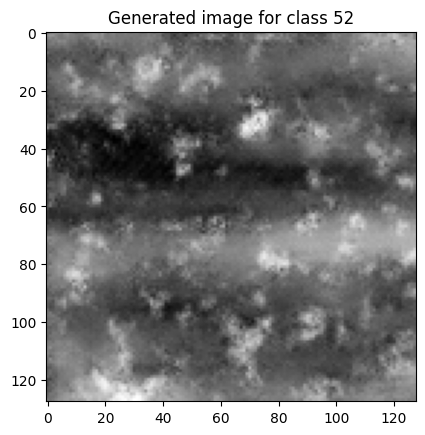

1.7666666666666666
1/1 [==============================] - 0s 27ms/step


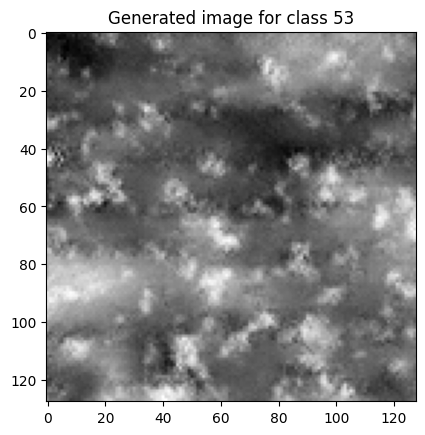

1.8
1/1 [==============================] - 0s 32ms/step


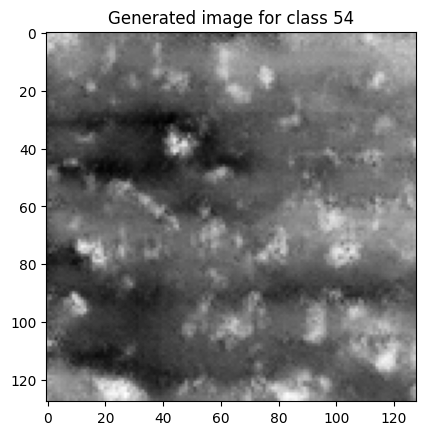

1.8333333333333335
1/1 [==============================] - 0s 30ms/step


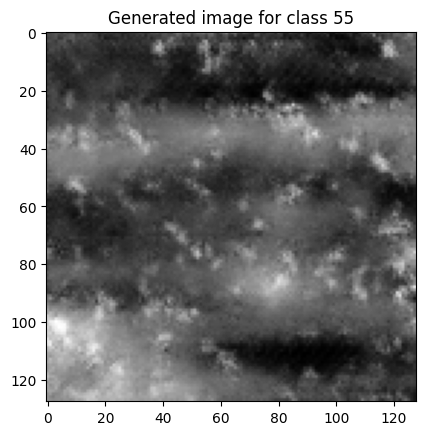

1.8666666666666667
1/1 [==============================] - 0s 29ms/step


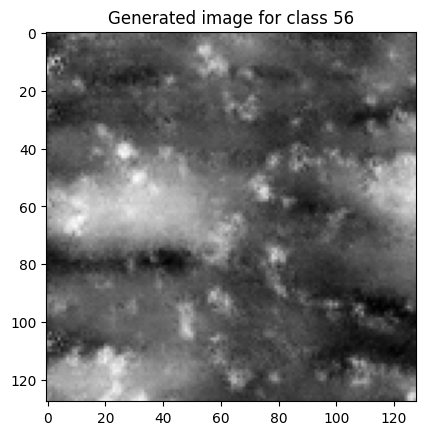

1.9
1/1 [==============================] - 0s 48ms/step


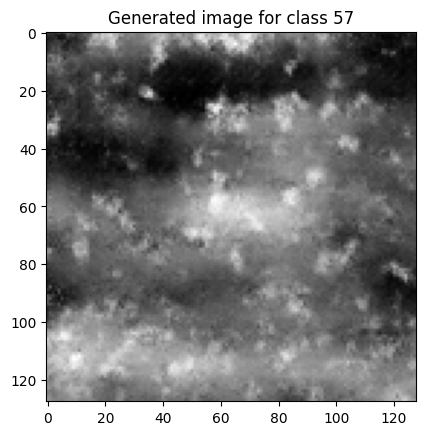

1.9333333333333333
1/1 [==============================] - 0s 46ms/step


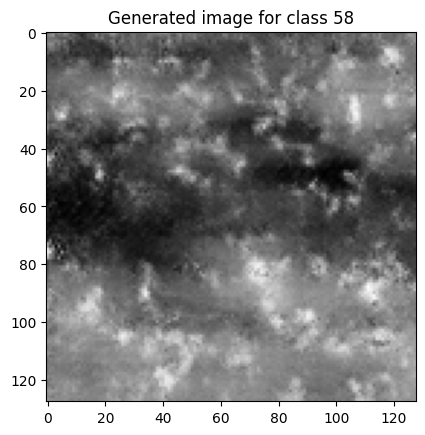

1.9666666666666668
1/1 [==============================] - 0s 34ms/step


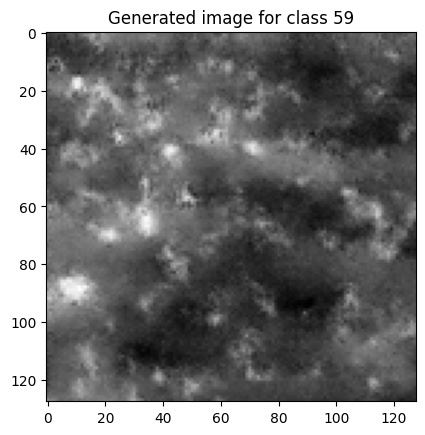

2.0
1/1 [==============================] - 0s 62ms/step


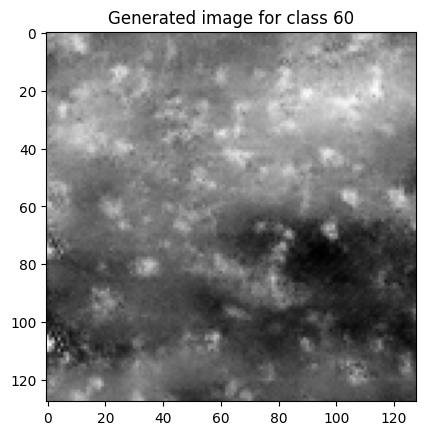

2.033333333333333
1/1 [==============================] - 0s 43ms/step


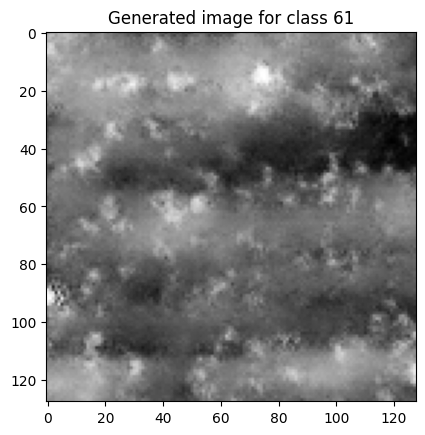

2.066666666666667
1/1 [==============================] - 0s 39ms/step


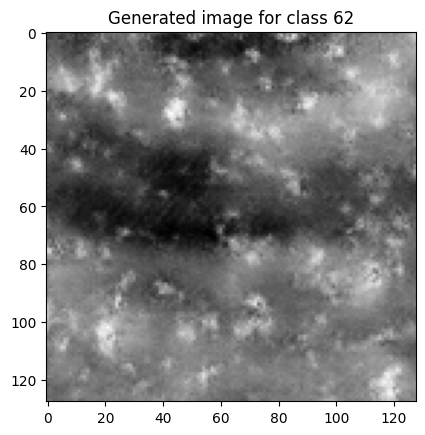

2.1
1/1 [==============================] - 0s 28ms/step


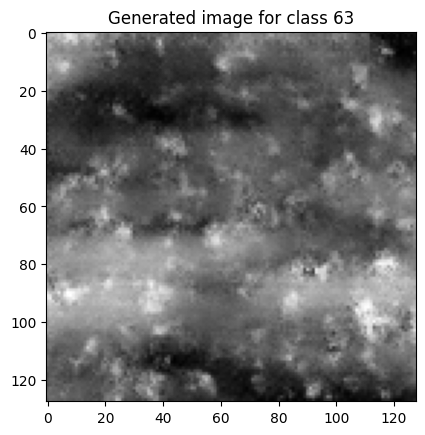

2.1333333333333333
1/1 [==============================] - 0s 28ms/step


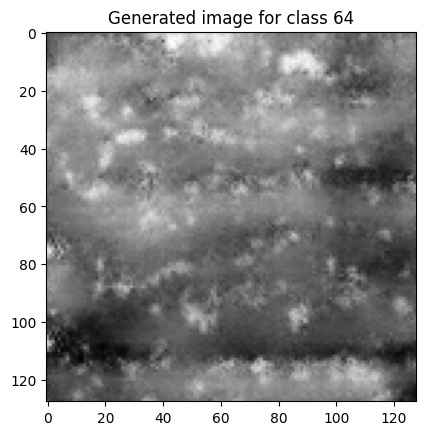

2.1666666666666665
1/1 [==============================] - 0s 33ms/step


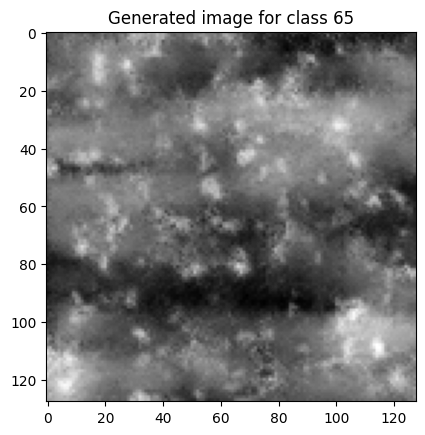

2.2
1/1 [==============================] - 0s 28ms/step


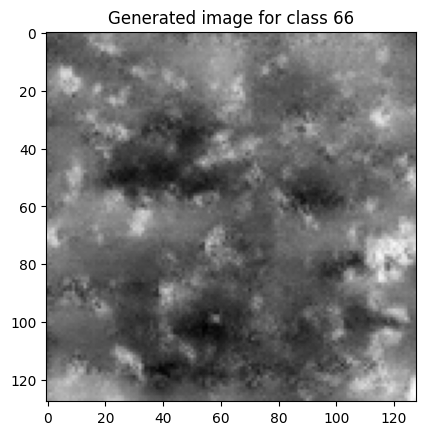

2.2333333333333334
1/1 [==============================] - 0s 27ms/step


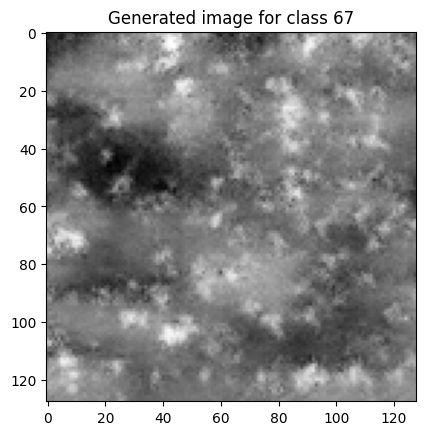

2.2666666666666666
1/1 [==============================] - 0s 27ms/step


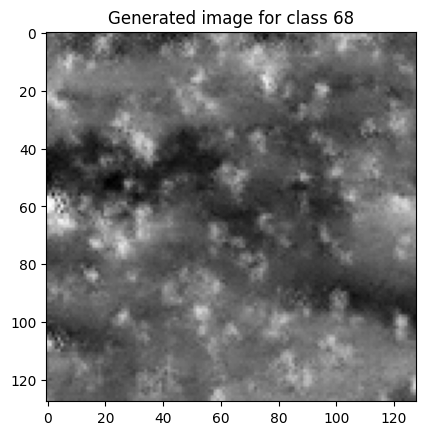

2.3
1/1 [==============================] - 0s 26ms/step


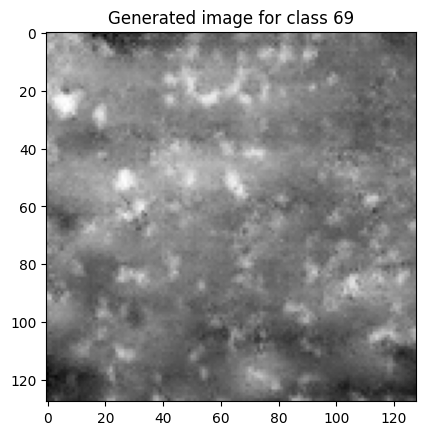

2.3333333333333335
1/1 [==============================] - 0s 28ms/step


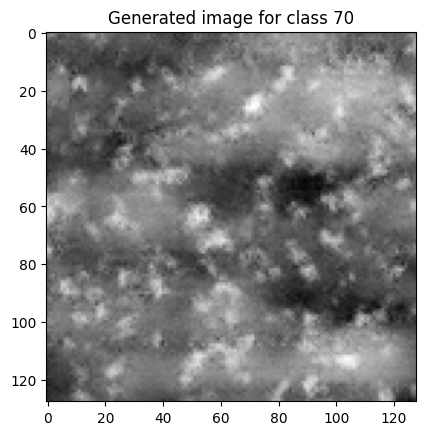

2.3666666666666667
1/1 [==============================] - 0s 29ms/step


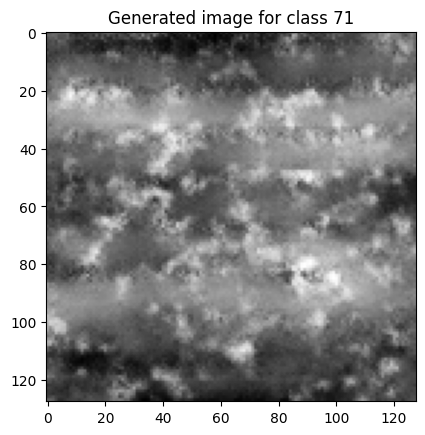

2.4
1/1 [==============================] - 0s 28ms/step


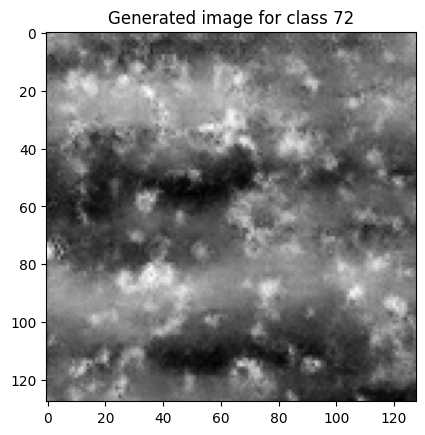

2.4333333333333336
1/1 [==============================] - 0s 27ms/step


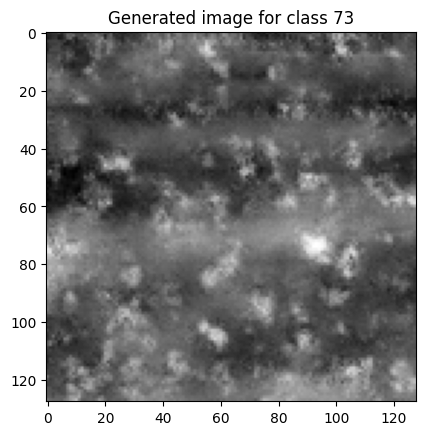

2.466666666666667
1/1 [==============================] - 0s 31ms/step


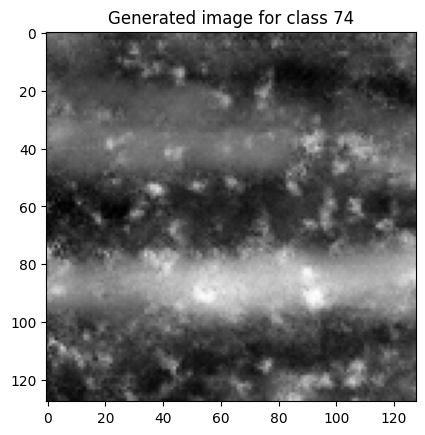

2.5
1/1 [==============================] - 0s 28ms/step


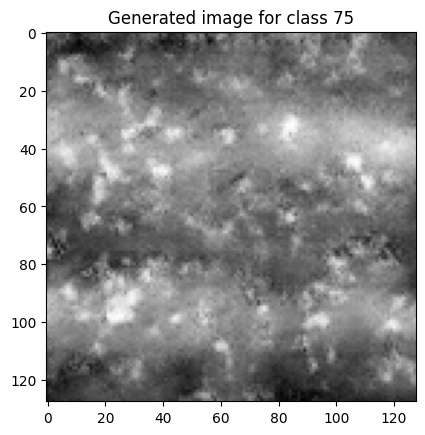

2.533333333333333
1/1 [==============================] - 0s 28ms/step


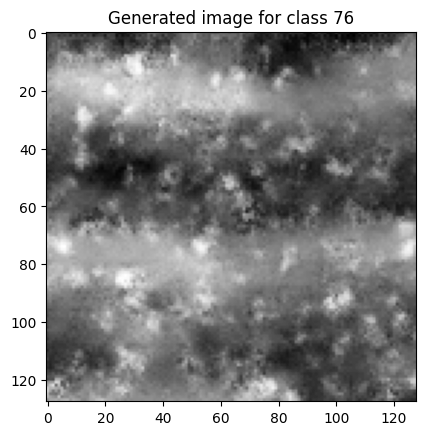

2.5666666666666664
1/1 [==============================] - 0s 26ms/step


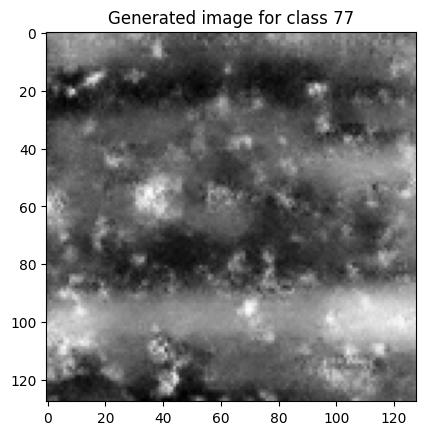

2.6
1/1 [==============================] - 0s 26ms/step


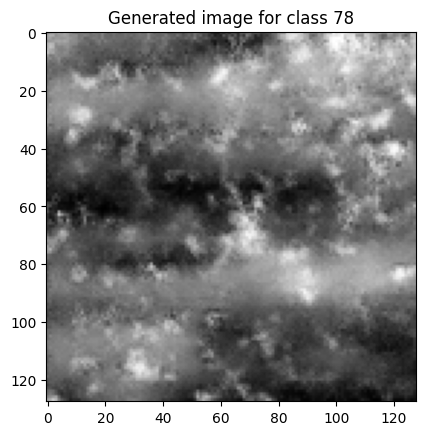

2.6333333333333333
1/1 [==============================] - 0s 28ms/step


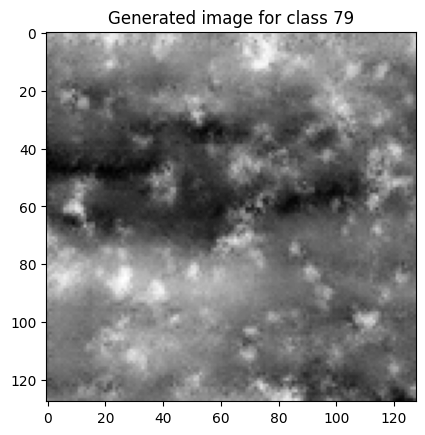

2.6666666666666665
1/1 [==============================] - 0s 30ms/step


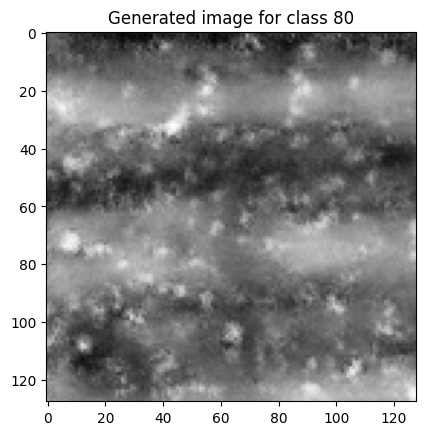

2.7
1/1 [==============================] - 0s 27ms/step


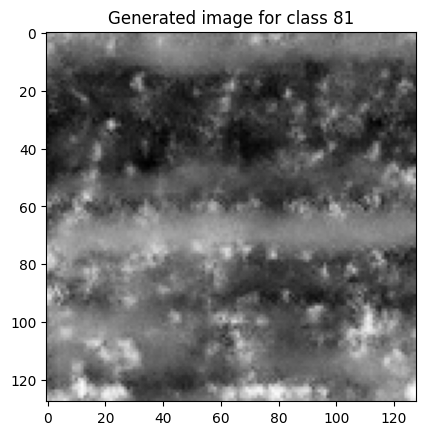

2.7333333333333334
1/1 [==============================] - 0s 36ms/step


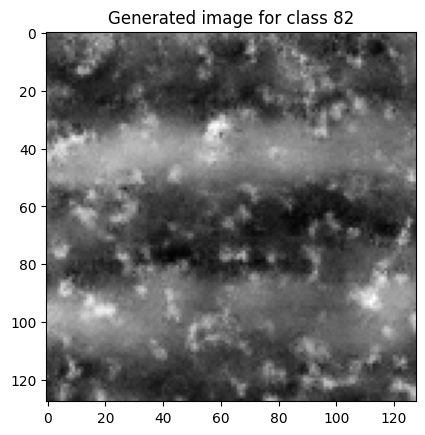

2.7666666666666666
1/1 [==============================] - 0s 26ms/step


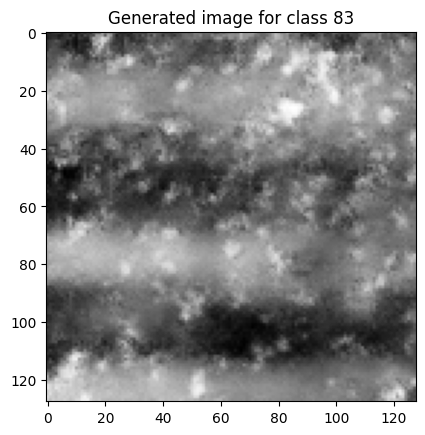

2.8
1/1 [==============================] - 0s 26ms/step


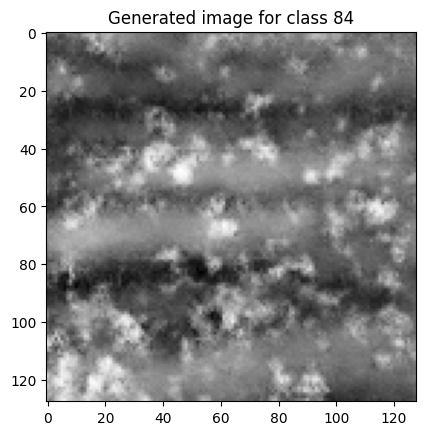

2.8333333333333335
1/1 [==============================] - 0s 27ms/step


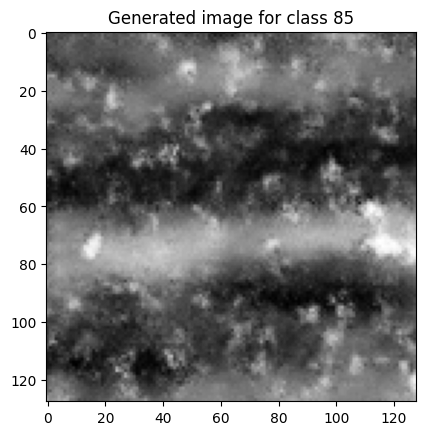

2.8666666666666667
1/1 [==============================] - 0s 29ms/step


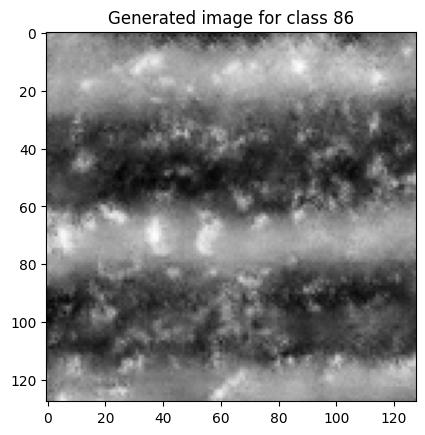

2.9
1/1 [==============================] - 0s 28ms/step


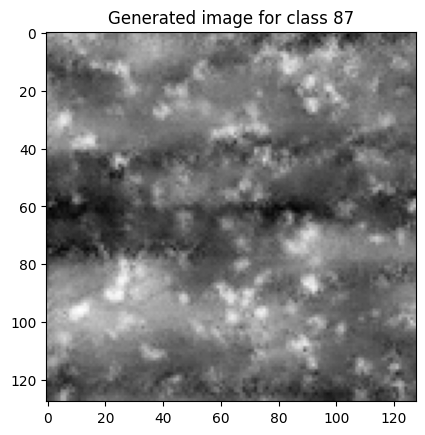

2.9333333333333336
1/1 [==============================] - 0s 29ms/step


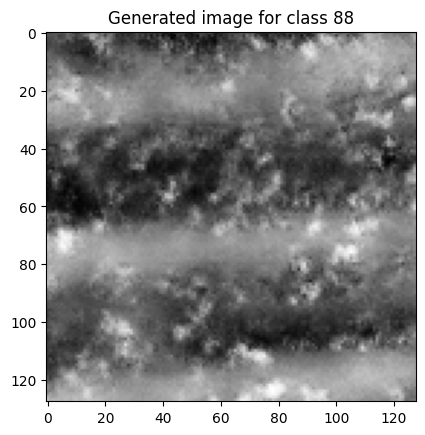

2.966666666666667
1/1 [==============================] - 0s 41ms/step


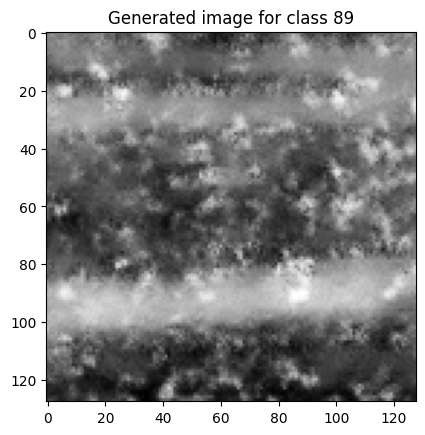

3.0
1/1 [==============================] - 0s 28ms/step


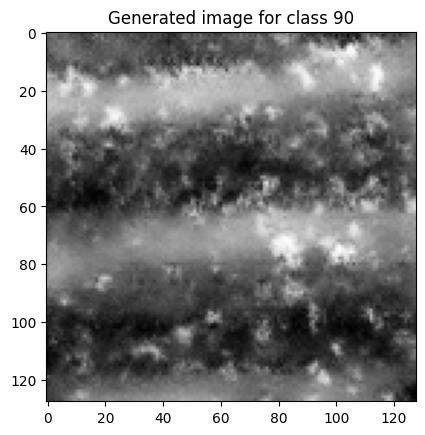

3.033333333333333
1/1 [==============================] - 0s 39ms/step


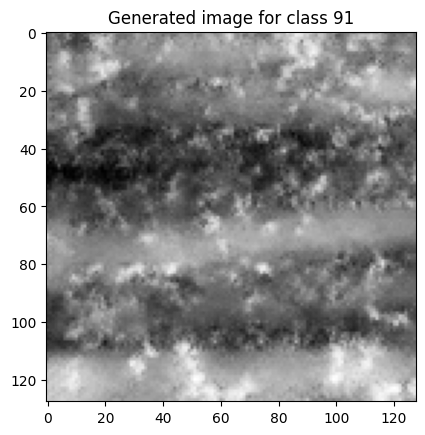

3.066666666666667
1/1 [==============================] - 0s 32ms/step


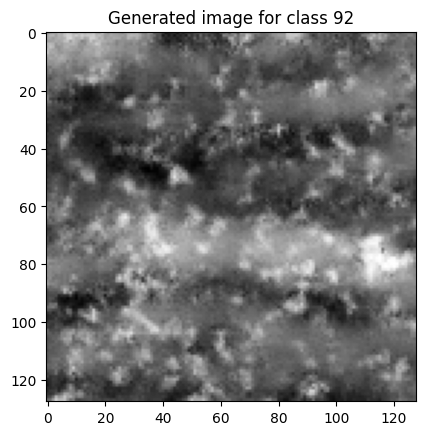

3.1
1/1 [==============================] - 0s 37ms/step


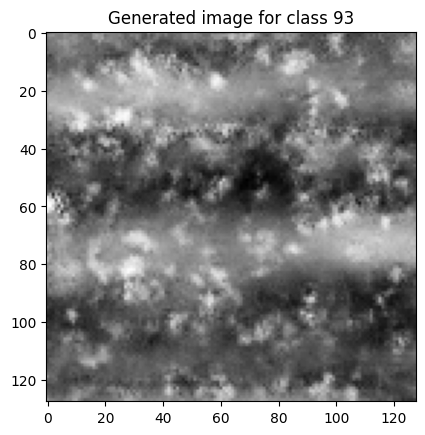

3.1333333333333333
1/1 [==============================] - 0s 26ms/step


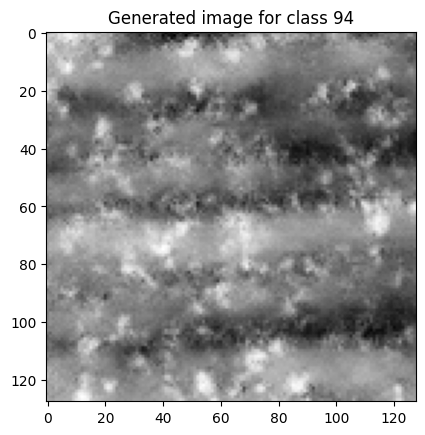

3.1666666666666665
1/1 [==============================] - 0s 43ms/step


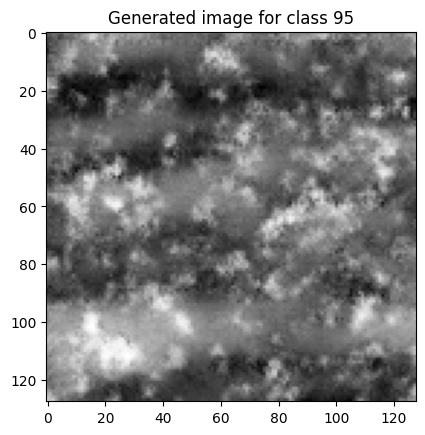

3.2
1/1 [==============================] - 0s 27ms/step


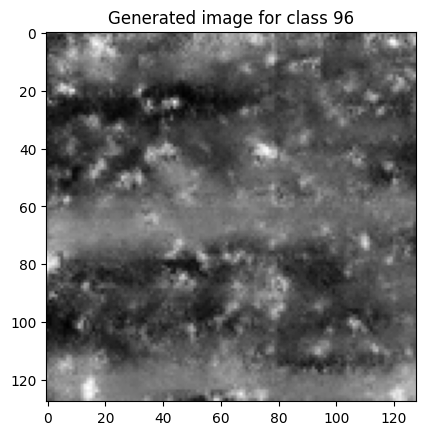

3.2333333333333334
1/1 [==============================] - 0s 28ms/step


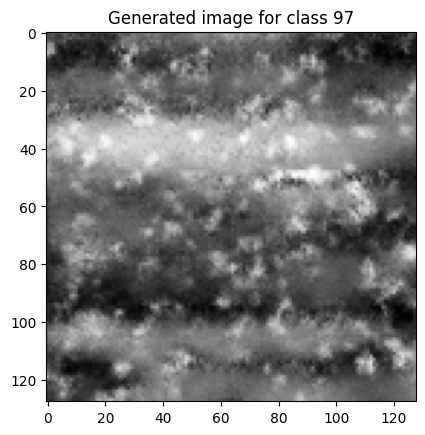

3.2666666666666666
1/1 [==============================] - 0s 45ms/step


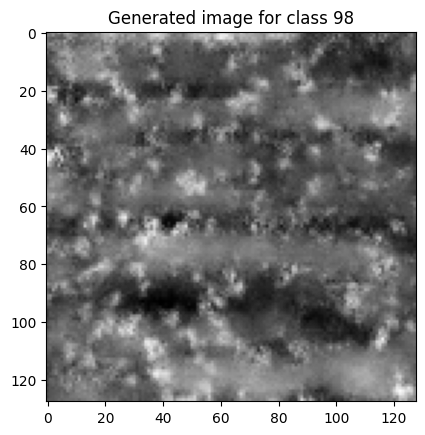

3.3
1/1 [==============================] - 0s 60ms/step


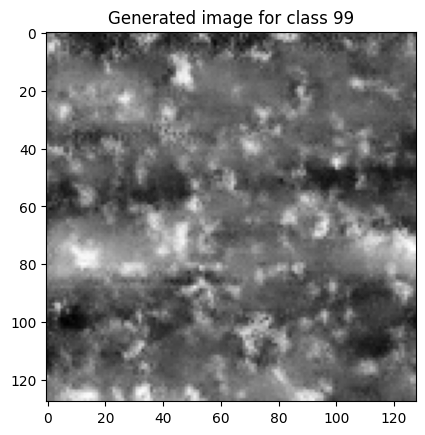

3.3333333333333335
1/1 [==============================] - 0s 40ms/step


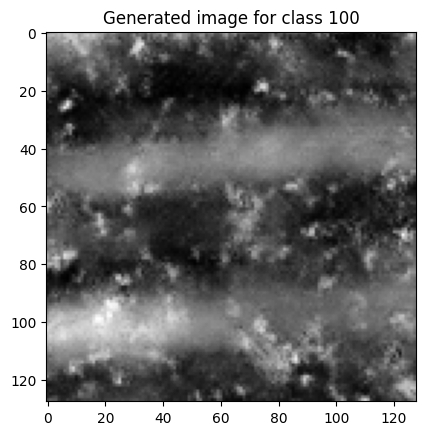

3.3666666666666667
1/1 [==============================] - 0s 25ms/step


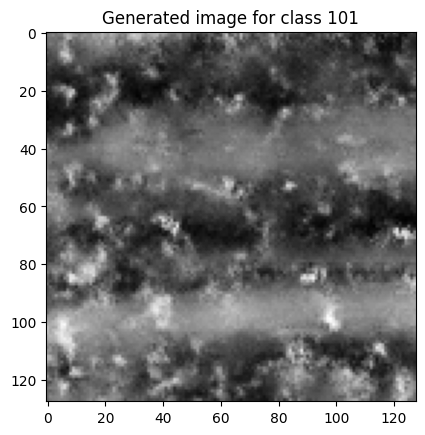

3.4
1/1 [==============================] - 0s 27ms/step


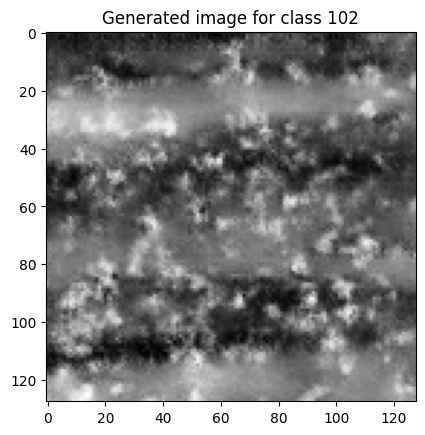

3.4333333333333336
1/1 [==============================] - 0s 33ms/step


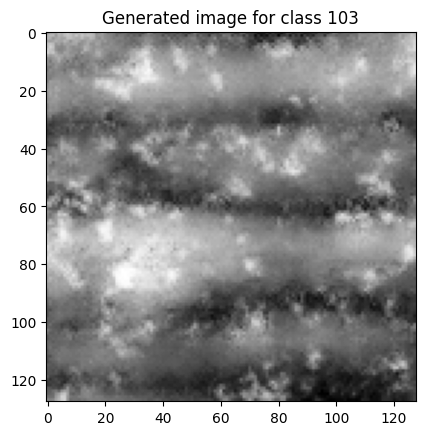

3.466666666666667
1/1 [==============================] - 0s 28ms/step


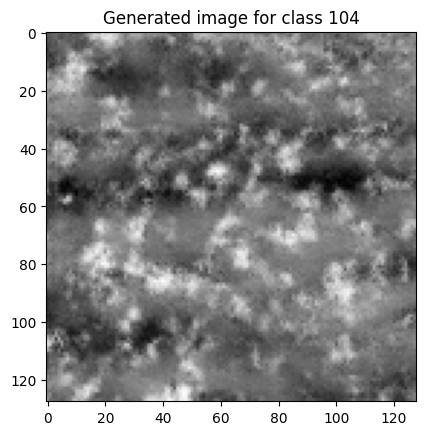

3.5
1/1 [==============================] - 0s 27ms/step


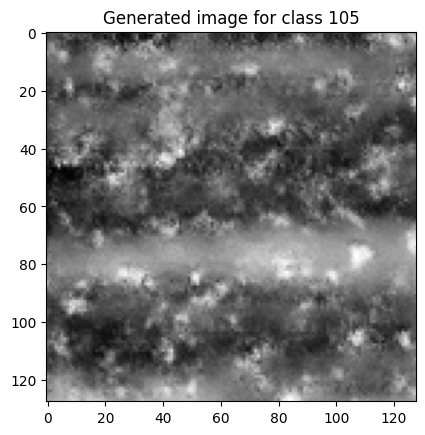

3.533333333333333
1/1 [==============================] - 0s 27ms/step


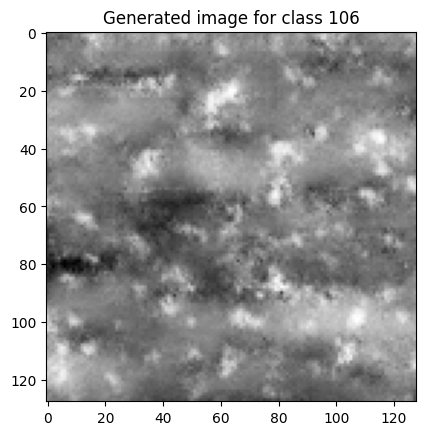

3.5666666666666664
1/1 [==============================] - 0s 27ms/step


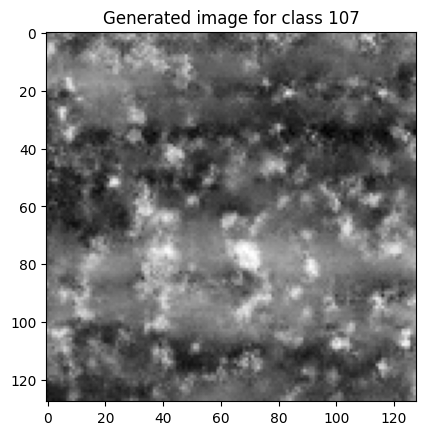

3.6
1/1 [==============================] - 0s 27ms/step


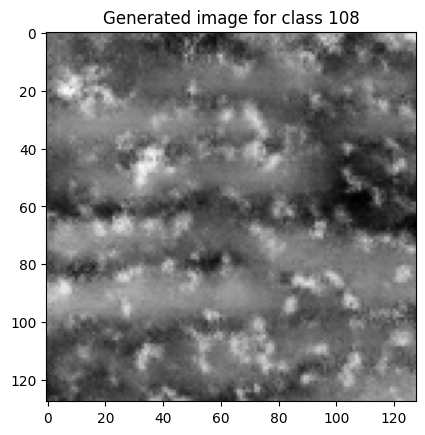

3.6333333333333333
1/1 [==============================] - 0s 25ms/step


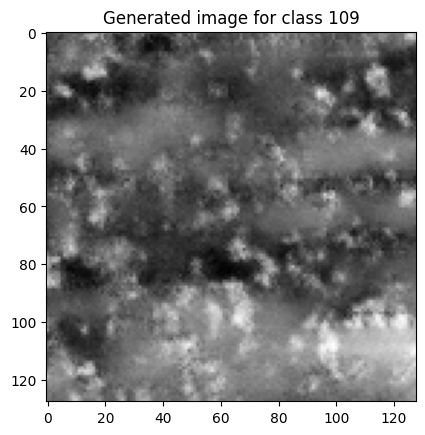

3.6666666666666665
1/1 [==============================] - 0s 34ms/step


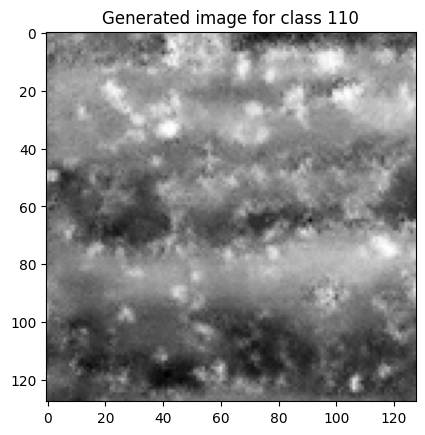

3.7
1/1 [==============================] - 0s 29ms/step


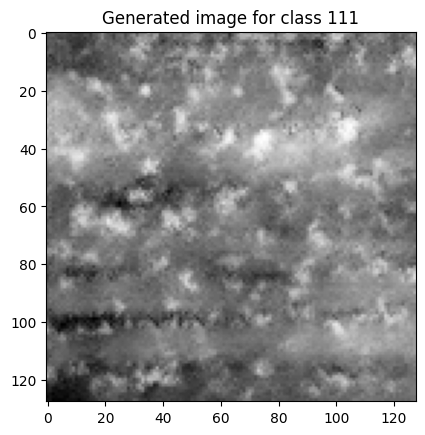

3.7333333333333334
1/1 [==============================] - 0s 26ms/step


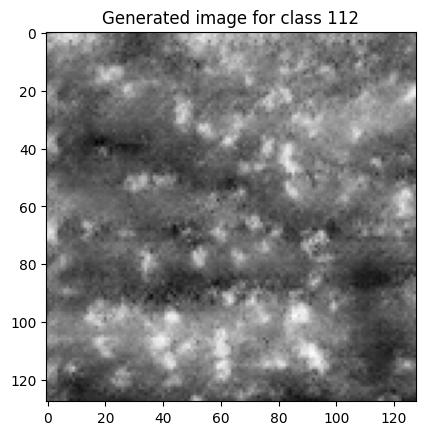

3.7666666666666666
1/1 [==============================] - 0s 26ms/step


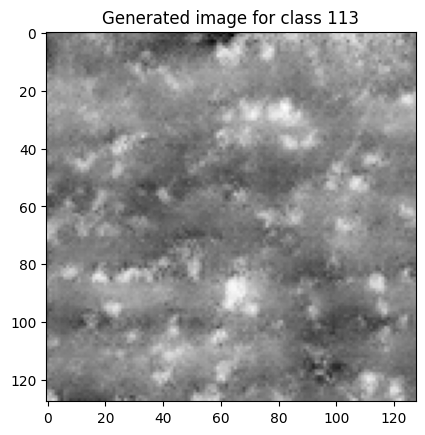

3.8
1/1 [==============================] - 0s 27ms/step


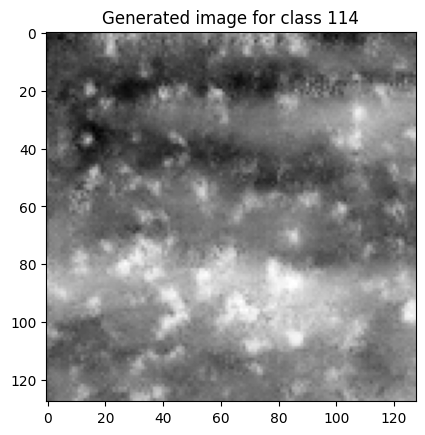

3.8333333333333335
1/1 [==============================] - 0s 26ms/step


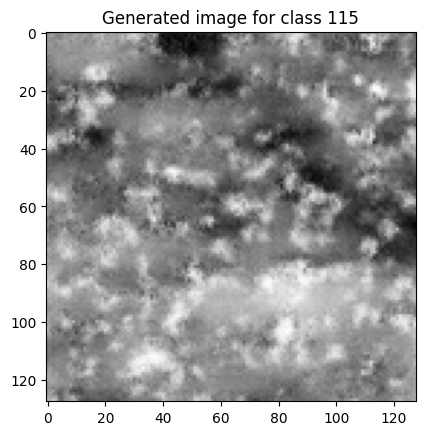

3.8666666666666667
1/1 [==============================] - 0s 44ms/step


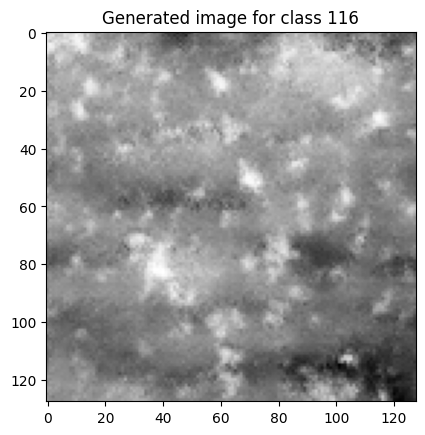

3.9
1/1 [==============================] - 0s 32ms/step


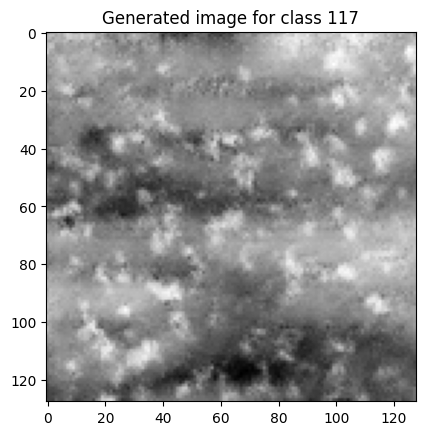

3.9333333333333336
1/1 [==============================] - 0s 35ms/step


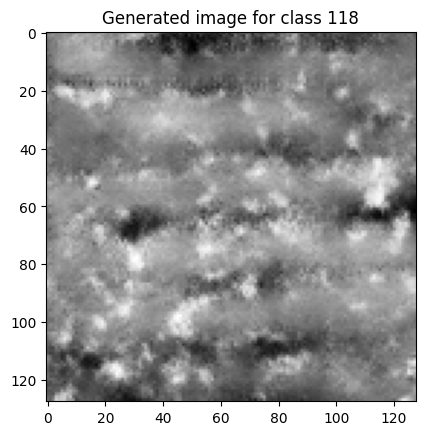

3.966666666666667
1/1 [==============================] - 0s 31ms/step


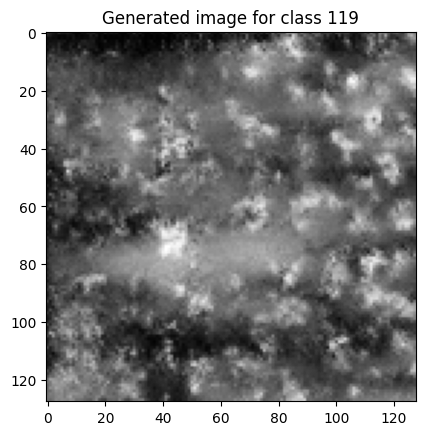

4.0
1/1 [==============================] - 0s 30ms/step


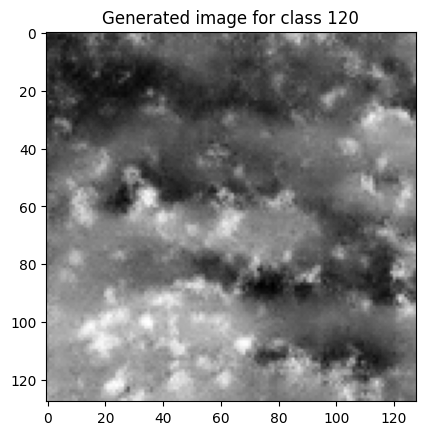

4.066666666666666
1/1 [==============================] - 0s 31ms/step


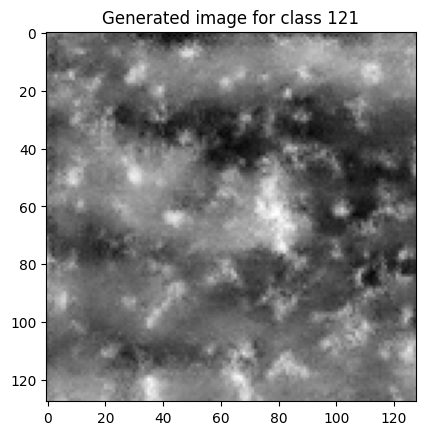

4.133333333333334
1/1 [==============================] - 0s 38ms/step


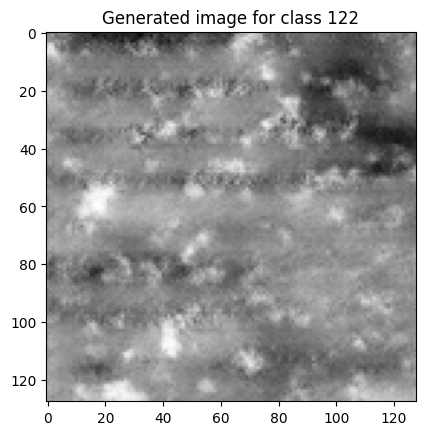

4.2
1/1 [==============================] - 0s 57ms/step


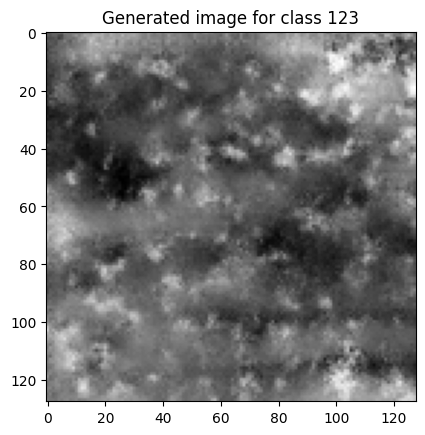

4.266666666666667
1/1 [==============================] - 0s 29ms/step


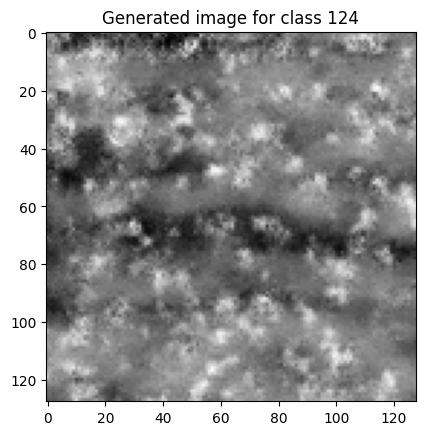

4.333333333333333
1/1 [==============================] - 0s 39ms/step


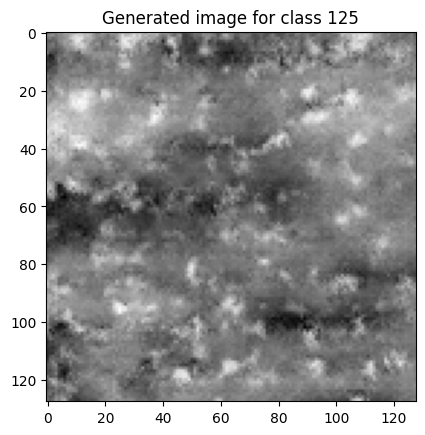

4.4
1/1 [==============================] - 0s 33ms/step


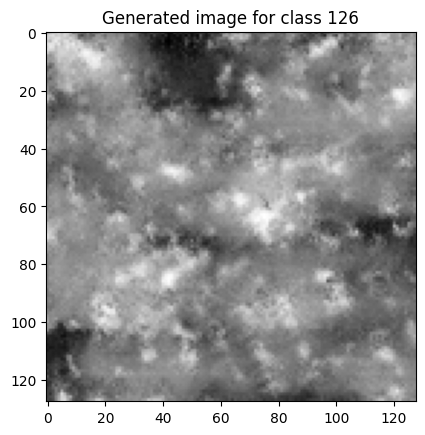

4.466666666666667
1/1 [==============================] - 0s 35ms/step


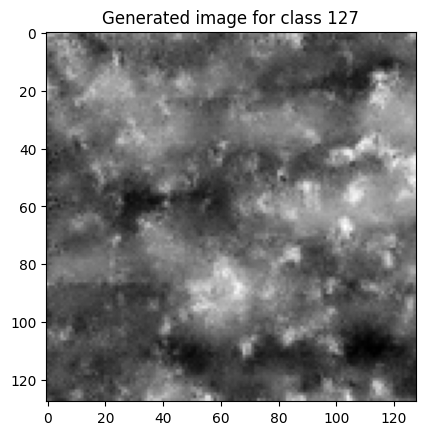

4.533333333333333
1/1 [==============================] - 0s 33ms/step


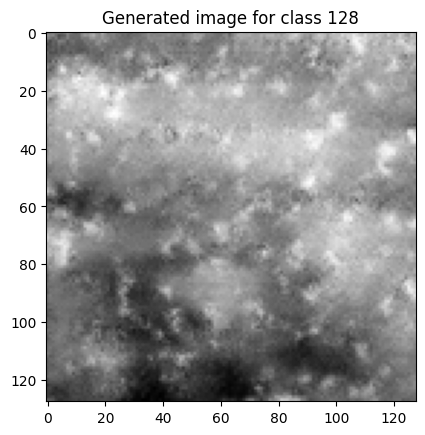

4.6
1/1 [==============================] - 0s 38ms/step


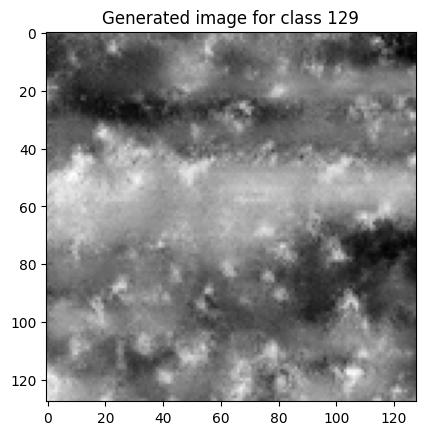

4.666666666666667
1/1 [==============================] - 0s 58ms/step


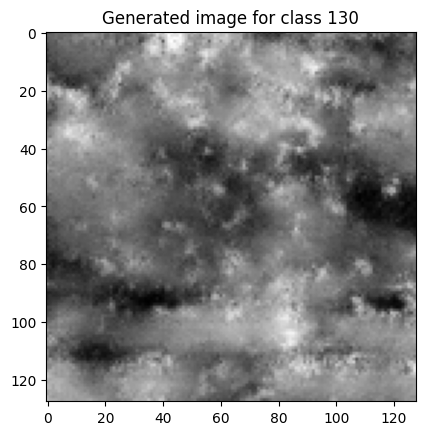

4.733333333333333
1/1 [==============================] - 0s 28ms/step


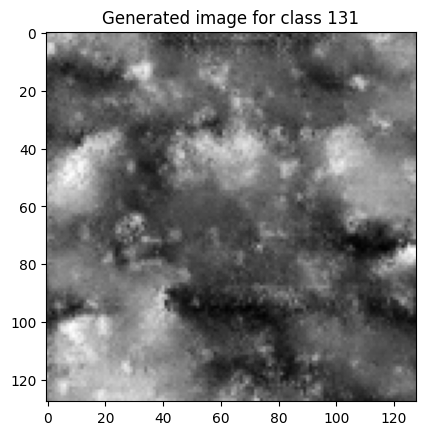

4.8
1/1 [==============================] - 0s 27ms/step


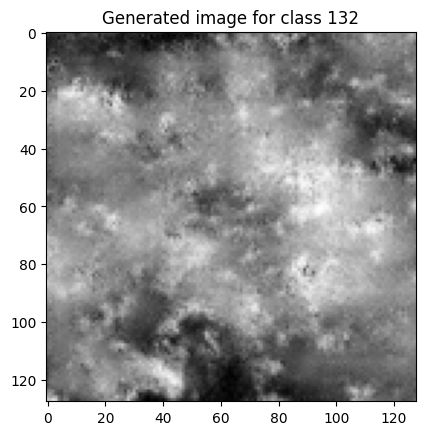

4.866666666666667
1/1 [==============================] - 0s 28ms/step


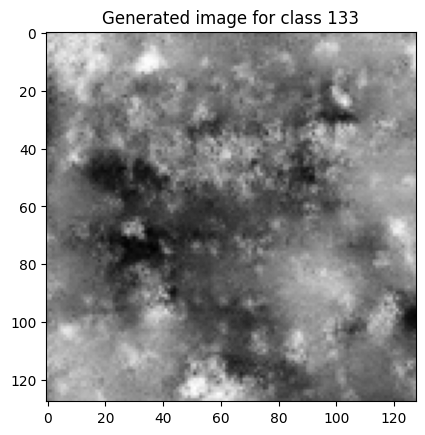

4.933333333333334
1/1 [==============================] - 0s 27ms/step


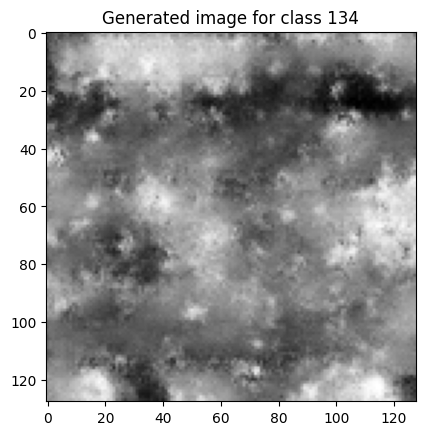

5.0
1/1 [==============================] - 0s 31ms/step


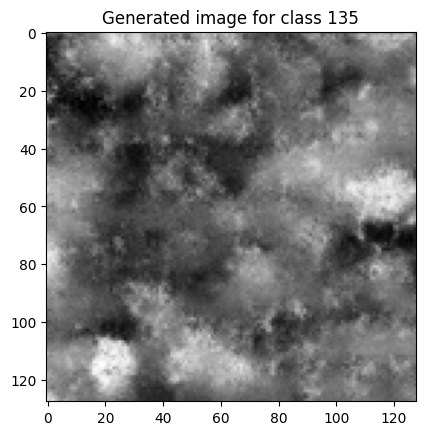

In [ ]:
# @title Run and save prediction 0-136 (Correct)




def interpolate_classes(generator, class1, class2, steps):
    # Create a batch of latent vectors. We'll generate one sample for each step.
    latent = tf.random.normal([steps, 100])

    # Create a vector of class labels, changing linearly from class1 to class2.
    interpolated_labels = np.zeros((steps, 6))  # Change this to match your number of classes
    for i in range(steps):
        alpha = i / (steps - 1)  # alpha goes from 0 to 1 as i goes from 0 to steps-1
        interpolated_labels[i, :] = (1 - alpha) * class1 + alpha * class2

    # Use the generator to generate images for each combination of latent vector and class label.
    generated_images = generator([latent, interpolated_labels])

    return generated_images


def reverse_interpolate_class(Trained_Class, input_value):
    # Define the corresponding class values
    Class_values = np.arange(len(Trained_Class))
    
    # Return the interpolated result
    return np.interp(input_value, Trained_Class, Class_values)




generator = tf.keras.models.load_model('drive/MyDrive/GAN/GEN_cGAN_0-135_955E.h5')
discriminator = tf.keras.models.load_model('drive/MyDrive/GAN/DIS_cGAN_0-135_955E.h5')


# Define the classes that the model was trained on
trained_classes = [0, 30, 60, 90, 120, 135]
# trained_classes = [0, 1,2,3,4,5]

# Encode the classes as one-hot vectors
trained_classes_one_hot = [tf.one_hot(i, depth=6) for i in range(6)]


# Define the class you want to generate (for example, "class 0.5" corresponding to 15 degrees)
for i in range(136):
  input_angle = i
  desired_class = reverse_interpolate_class(trained_classes, input_angle)
  print(desired_class)




  # Find the two closest trained classes
  closest_classes = sorted(range(6), key=lambda x: abs(x - desired_class))[:2]
  class1, class2 = closest_classes

  # Find the corresponding one-hot encoded classes
  class1_one_hot = trained_classes_one_hot[class1]
  class2_one_hot = trained_classes_one_hot[class2]

  # Calculate the interpolation coefficient
  total_diff = class2 - class1
  desired_diff = desired_class - class1
  alpha = desired_diff / total_diff

  # Interpolate between the two closest trained classes
  interpolated_class = (1 - alpha) * class1_one_hot + alpha * class2_one_hot

  # Generate and display the image
  interpolated_images = generator.predict([np.random.normal(0, 1, (1, 100)), np.array([interpolated_class])])
  generated_image = interpolated_images[0]
  generated_image = (generated_image[:, :, 0] * 32768.0 + 32768.0).astype(np.uint16)

  # Display The Image
  plt.imshow(generated_image, cmap='gray')
  plt.title(f'Generated image for class {input_angle}')
  plt.show()

  output_dir = ''
  imageio.imwrite(os.path.join(output_dir, f'{input_angle}.png'), generated_image)


In [ ]:
# '''
# PRE-REQUISITE TO RUN THE HEIGHTMAP APPLICATION BELOW:
# '''

# !pip install pyvista


In [ ]:
#@title [OLD] - Apply One Heightmap To Cube

# '''
# APPLY ONE HEIGHMAP TO CUBE 
# '''

# import numpy as np
# import pyvista as pv
# import cv2
# from tqdm import tqdm

# # Load the STL file
# mesh = pv.read('cube_remeshed_3.stl')

# # Load the heightmap
# heightmap = cv2.imread('1.png', cv2.IMREAD_UNCHANGED)

# # Calculate the size of the mesh from its bounds
# bounds = mesh.bounds
# size = (int(bounds[1] - bounds[0]), int(bounds[3] - bounds[2]))

# # Calculate the number of times the heightmap needs to be tiled in each dimension
# tiling = (size[0] // heightmap.shape[1] + 1, size[1] // heightmap.shape[0] + 1)

# # Tile the heightmap to cover the entire surface area of the mesh
# heightmap_tiled = np.tile(heightmap, tiling)

# # Crop the tiled heightmap to match the size of the mesh
# heightmap_cropped = heightmap_tiled[:size[1], :size[0]]

# # Normalize the heightmap values to a reasonable range for displacement
# heightmap_normalized = heightmap_cropped / np.max(heightmap_cropped)

# # Repeat the heightmap values to match the number of points in the mesh
# repeated_heightmap = np.tile(heightmap_normalized.flatten(), (mesh.n_points // heightmap_normalized.size) + 1)
# heightmap_values = repeated_heightmap[:mesh.n_points]

# # Compute the normals for each point in the mesh
# normals = mesh.compute_normals(point_normals=True, cell_normals=False)

# # Create a copy of the STL mesh to apply the displacement to
# mesh_displaced = mesh.copy()

# # Apply the heightmap as a displacement map along the normal vectors of the STL file
# with tqdm(total=mesh_displaced.n_points, ncols=80) as pbar:
#     for i in range(mesh_displaced.n_points):
#         mesh_displaced.points[i] += heightmap_values[i] * normals['Normals'][i]
#         pbar.update(1)

# # Save the displaced mesh as a new STL file
# mesh_displaced.save('cube_displaced.stl')



In [ ]:
#@title [OLD] Apply Heightmaps to hardcoded angles

# '''
# apply different heightmaps depending to hard coded angles
# '''


# import numpy as np
# import pyvista as pv
# import cv2
# from tqdm import tqdm

# # Load the STL file
# mesh = pv.read('cube_remeshed_3.stl')

# # Load the heightmaps for different angles
# heightmap_0 = cv2.imread('1.png', cv2.IMREAD_UNCHANGED)
# heightmap_90 = cv2.imread('90.png', cv2.IMREAD_UNCHANGED)
# heightmap_180 = cv2.imread('180.png', cv2.IMREAD_UNCHANGED)

# # Calculate the size of the mesh from its bounds
# bounds = mesh.bounds
# size = (int(bounds[1] - bounds[0]), int(bounds[3] - bounds[2]))

# # Calculate the number of times each heightmap needs to be tiled in each dimension
# tiling_0 = (size[0] // heightmap_0.shape[1] + 1, size[1] // heightmap_0.shape[0] + 1)
# tiling_90 = (size[0] // heightmap_90.shape[1] + 1, size[1] // heightmap_90.shape[0] + 1)
# tiling_180 = (size[0] // heightmap_180.shape[1] + 1, size[1] // heightmap_180.shape[0] + 1)

# # Tile each heightmap to cover the surface area of the mesh
# heightmap_tiled_0 = np.tile(heightmap_0, tiling_0)
# heightmap_tiled_90 = np.tile(heightmap_90, tiling_90)
# heightmap_tiled_180 = np.tile(heightmap_180, tiling_180)

# # Crop the tiled heightmaps to match the size of the mesh
# heightmap_cropped_0 = heightmap_tiled_0[:size[1], :size[0]]
# heightmap_cropped_90 = heightmap_tiled_90[:size[1], :size[0]]
# heightmap_cropped_180 = heightmap_tiled_180[:size[1], :size[0]]

# # Normalize the heightmap values to a reasonable range for displacement
# heightmap_normalized_0 = heightmap_cropped_0 / np.max(heightmap_cropped_0)
# heightmap_normalized_90 = heightmap_cropped_90 / np.max(heightmap_cropped_90)
# heightmap_normalized_180 = heightmap_cropped_180 / np.max(heightmap_cropped_180)

# # Compute the normals for each point in the mesh
# normals = mesh.compute_normals(point_normals=True, cell_normals=False)

# # Create a copy of the STL mesh to apply the displacement to
# mesh_displaced = mesh.copy()
# # Apply the heightmap as a displacement map along the normal vectors of the STL file
# with tqdm(total=mesh_displaced.n_points, ncols=80) as pbar:
#     for i in range(mesh_displaced.n_points):
#         # Determine the angle of the surface based on the z component of the normal
#         angle = np.arccos(normals['Normals'][i][2]) * 180 / np.pi
#         # print(angle)
#         # Use the corresponding heightmap based on the angle
#         if int(angle) == 0:
#             heightmap_values = heightmap_normalized_0.flatten()
#         elif int(angle) == 90:
#             heightmap_values = heightmap_normalized_90.flatten()
#         elif int(angle) == 180:
#             heightmap_values = heightmap_normalized_180.flatten()*10
#         else:
#             # Handle other angles here
#             heightmap_values = np.zeros_like(heightmap_normalized_0).flatten()

#         heightmap_index = i % len(heightmap_values)
#         mesh_displaced.points[i] += heightmap_values[heightmap_index] * normals['Normals'][i]
#         pbar.update(1)

# # Save the displaced mesh as a new STL file
# mesh_displaced.save('cube_displaced.stl')


In [ ]:
#@title [OLD] Apply different Heightmap on STL object depending on the angle - some slight adjustment

# import numpy as np
# import pyvista as pv
# import cv2
# from tqdm import tqdm

# # Maximum 16-bit value
# max_16bit = 65535

# # Conversion factor from image units to millimeters
# image_to_mm = 0.5 / max_16bit  # Change this value to your specific conversion factor

# print('Reading the file')
# mesh = pv.read('Part Studio 1_displaced_HighRes.stl')

# print('Calculating the size of the mesh from its bounds')
# bounds = mesh.bounds
# size = (int(bounds[1] - bounds[0]), int(bounds[3] - bounds[2]))

# normals = mesh.compute_normals(point_normals=True, cell_normals=False)

# mesh_displaced = mesh.copy()

# print('Starting to apply heightmaps onto STL surface')
# with tqdm(total=mesh_displaced.n_points, ncols=80) as pbar:
#     for i in range(mesh_displaced.n_points):
#         angle = np.arccos(normals['Normals'][i][2]) * 180 / np.pi
#         heightmap_path = f"{int(angle)}.png"
#         try:
#             heightmap = cv2.imread(heightmap_path, cv2.IMREAD_UNCHANGED)
#             if heightmap is None:
#                 raise FileNotFoundError("Heightmap file not found.")

#             # Convert image units to millimeters
#             heightmap_mm = heightmap * image_to_mm

#             # Get the heightmap value based on the position of the point in the mesh
#             mesh_point = mesh_displaced.points[i]
#             heightmap_value = heightmap_mm[int(mesh_point[0] % heightmap.shape[0]), int(mesh_point[1] % heightmap.shape[1])]
#         except FileNotFoundError:
#             heightmap_value = 0.0

#         # Apply the heightmap as a displacement map along the normal vectors of the STL file
#         mesh_displaced.points[i] += heightmap_value * normals['Normals'][i]
#         pbar.update(1)

# print('Completed Calculation, Saving File')
# mesh_displaced.save('./drive/MyDrive/GAN/Part Studio 1_displaced_HighRes.stl')

# print('Save completed')


In [ ]:
# @title [WORKING] Apply different Heightmap on STL object depending on the angle
'''
apply different heightmaps depending on the angle
'''

import numpy as np
import pyvista as pv
import cv2
from tqdm import tqdm

print('Reading the file')
# Load the STL file
mesh = pv.read('Part Studio 1_Remeshed.stl')

print('Calculating the size of the mesh from its bounds')
# Calculate the size of the mesh from its bounds
bounds = mesh.bounds
size = (int(bounds[1] - bounds[0]), int(bounds[3] - bounds[2]))

# Compute the normals for each point in the mesh
normals = mesh.compute_normals(point_normals=True, cell_normals=False)

# Create a copy of the STL mesh to apply the displacement to
mesh_displaced = mesh.copy()

print('Starting to apply heightmaps onto STL surface')
# Apply the heightmap as a displacement map along the normal vectors of the STL file
with tqdm(total=mesh_displaced.n_points, ncols=80) as pbar:
    for i in range(mesh_displaced.n_points):
        # Determine the angle of the surface based on the z component of the normal
        angle = np.arccos(normals['Normals'][i][2]) * 180 / np.pi
        
        # Load the heightmap image based on the angle
        heightmap_path = f"{int(angle)}.png"
        try:
            # print(heightmap_path)
            heightmap = cv2.imread(heightmap_path, cv2.IMREAD_UNCHANGED)
            if heightmap is None:
                raise FileNotFoundError("Heightmap file not found.")
            # print(heightmap.shape)
            # Normalize the heightmap values to a reasonable range for displacement
            heightmap_normalized = heightmap / np.max(heightmap)
        except FileNotFoundError:
            # Handle case where the heightmap file does not exist
            heightmap_normalized = np.zeros_like((128,128))
        
        # Repeat the heightmap values to match the number of points in the mesh
        repeated_heightmap = np.tile(heightmap_normalized.flatten(), (mesh_displaced.n_points // heightmap_normalized.size) + 1)
        heightmap_values = repeated_heightmap[:mesh_displaced.n_points]
        
        # Apply the heightmap as a displacement map along the normal vectors of the STL file
        mesh_displaced.points[i] += heightmap_values[i] * normals['Normals'][i]
        pbar.update(1)

print('Completed Calculation, Saving File')
# Save the displaced mesh as a new STL file
mesh_displaced.save('./drive/MyDrive/GAN/Part Studio 1_test3times.stl')

print('Save completed')


Reading the file
Calculating the size of the mesh from its bounds
Starting to apply heightmaps onto STL surface


100%|██████████████████████████████████| 193859/193859 [03:45<00:00, 861.16it/s]


Completed Calculation, Saving File
Save completed
